# <p style="text-align: center;">Lending Club Case Study</p>

##### Objective:
Loan company wants to understand the driving factors (or driver variables) behind loan default, i.e. the variables which are strong indicators of default. The company can utilise this knowledge for its portfolio and risk assessment.

<br>

- Loan dataset contains information about past loan applicants from 2007 to 2011 and whether they ‘defaulted’ or not. The aim is to identify patterns which indicate if a person is likely to default, which may be used for taking actions such as denying the loan, reducing the amount of loan, lending (to risky applicants) at a higher interest rate, etc.


#### Procedure:
- Drop Null Columns/Rows
- Drop Columns with one Unique value.
- Drop Unnecessary Columns.
- Convert dtype of columns according to analysis.
- Split Date columns to month and year to ease analysis
- Treating numerical columns missing values with Median
- Treating categorical missing values with Mode.
- Split Columns to Numerical, Categorical and Extra columns.
- Perform Univariate on Numerical aand remove outliers.
- Perform Univariate on Categorical to understand the spread of data.
- Perform Bivariate on Numerical and Categorical.
- Finally Multivariate analysis on Numerical columns.

In [1]:
#Importing Libraries
import pandas as pd
import numpy as np

#importing Data Visualisation tools
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px

#Importing warnings to supress unnecessary warnings
import warnings
warnings.filterwarnings("ignore")

loan = pd.read_csv('loan.csv')

loan.head()

,id,member_id,loan_amnt,funded_amnt,funded_amnt_inv,term,int_rate,installment,grade,sub_grade,...,num_tl_90g_dpd_24m,num_tl_op_past_12m,pct_tl_nvr_dlq,percent_bc_gt_75,pub_rec_bankruptcies,tax_liens,tot_hi_cred_lim,total_bal_ex_mort,total_bc_limit,total_il_high_credit_limit
0,1077501,1296599,5000,5000,4975.0,36 months,10.65%,162.87,B,B2,...,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN
1,1077430,1314167,2500,2500,2500.0,60 months,15.27%,59.83,C,C4,...,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN
2,1077175,1313524,2400,2400,2400.0,36 months,15.96%,84.33,C,C5,...,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN
3,1076863,1277178,10000,10000,10000.0,36 months,13.49%,339.31,C,C1,...,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN
4,1075358,1311748,3000,3000,3000.0,60 months,12.69%,67.79,B,B5,...,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN


In [2]:
#shape of loan dataframe
loan.shape

(39717, 111)

In [3]:
loan.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 39717 entries, 0 to 39716
Columns: 111 entries, id to total_il_high_credit_limit
dtypes: float64(74), int64(13), object(24)
memory usage: 33.6+ MB


##### Checking Null Columns

In [4]:
round(100 * loan.isnull().mean(),2).value_counts()

100.00    54
0.00      43
0.14       2
6.19       1
2.71       1
32.59      1
0.03       1
64.66      1
92.99      1
0.13       1
0.18       1
97.13      1
0.01       1
1.75       1
0.10       1
Name: count, dtype: int64

##### Droping columns with 100% null values

In [5]:
loan = loan.dropna(how = "all", axis=1)

In [6]:
#After removing null columns shape of dataframe
loan.shape

(39717, 57)

##### Checking Percentage of Missing values in each column

In [7]:
round(100 * loan.isna().mean(),2)

id                             0.00
member_id                      0.00
loan_amnt                      0.00
funded_amnt                    0.00
funded_amnt_inv                0.00
term                           0.00
int_rate                       0.00
installment                    0.00
grade                          0.00
sub_grade                      0.00
emp_title                      6.19
emp_length                     2.71
home_ownership                 0.00
annual_inc                     0.00
verification_status            0.00
issue_d                        0.00
loan_status                    0.00
pymnt_plan                     0.00
url                            0.00
desc                          32.59
purpose                        0.00
title                          0.03
zip_code                       0.00
addr_state                     0.00
dti                            0.00
delinq_2yrs                    0.00
earliest_cr_line               0.00
inq_last_6mths              

###### Dropping Columns with more than 50% Missing Values

In [8]:
loan = loan.drop(['mths_since_last_delinq','mths_since_last_record','next_pymnt_d','desc'],axis=1)

In [9]:
loan.shape

(39717, 53)

###### Dropping columns with single unique value

In [10]:
loan = loan.loc[:, loan.apply(pd.Series.nunique) != 1]

In [11]:
loan.shape

(39717, 44)

##### Dropping Unnecessary Columns

In [12]:
# Drop_them list having columns which are applicable for loan already approved candidates.
# Our analysis is to get columns before loan approval, which are most affecting defaulters. So, drop them

Drop_them = ['url','zip_code', 'earliest_cr_line','out_prncp', 'out_prncp_inv', 'total_pymnt', 'total_pymnt_inv','total_rec_prncp', 'total_rec_int', 'total_rec_late_fee', 'recoveries', 'collection_recovery_fee', 'last_pymnt_d', 'last_pymnt_amnt','last_credit_pull_d']
loan = loan.drop(Drop_them, axis=1)

##### Converting dtype of Columns

In [13]:
def to_float(x):
    '''
    This function removes '%' symbol and returns value with converted dtype to float
    '''
    x = str(x).replace('%', '')
    return float(x)

loan.int_rate = loan.int_rate.apply(to_float)
loan.revol_util = loan.revol_util.apply(to_float)


In [14]:
loan.int_rate.describe()

count    39717.000000
mean        12.021177
std          3.724825
min          5.420000
25%          9.250000
50%         11.860000
75%         14.590000
max         24.590000
Name: int_rate, dtype: float64

In [15]:
loan.revol_util.describe()

count    39667.000000
mean        48.832152
std         28.332634
min          0.000000
25%         25.400000
50%         49.300000
75%         72.400000
max         99.900000
Name: revol_util, dtype: float64

##### Splitting Date column

In [16]:
loan['issue_m'] = loan.issue_d.apply(lambda x: x[0:3])
loan['issue_y'] = loan.issue_d.apply(lambda x: x[4:])

In [17]:
#issue date separated into issue_m and issue_y so drop issue_d column
loan = loan.drop('issue_d', axis=1)

In [18]:
# Current: Applicant is in the process of paying the instalments, i.e. the tenure of the loan is not yet completed. These candidates are not labelled as 'defaulted'.

#drop data with loan status related to current.
loan = loan[loan.loan_status != "Current"]

##### Checking missing values

In [19]:
loan.isna().sum()

id                         0
member_id                  0
loan_amnt                  0
funded_amnt                0
funded_amnt_inv            0
term                       0
int_rate                   0
installment                0
grade                      0
sub_grade                  0
emp_title               2386
emp_length              1033
home_ownership             0
annual_inc                 0
verification_status        0
loan_status                0
purpose                    0
title                     11
addr_state                 0
dti                        0
delinq_2yrs                0
inq_last_6mths             0
open_acc                   0
pub_rec                    0
revol_bal                  0
revol_util                50
total_acc                  0
pub_rec_bankruptcies     697
issue_m                    0
issue_y                    0
dtype: int64

##### Treating Missing values in emp_length column

In [20]:
#It has both object type and float type values
loan.emp_length.apply(lambda x: type(x)).value_counts()

emp_length
<class 'str'>      37544
<class 'float'>     1033
Name: count, dtype: int64

###### Correcting and converting emp_length  values, object dtype to float.

In [21]:
# Employment length in years. Possible values are between 0 and 10 where 0 means less than one year and 10 means ten or more years. 
loan.emp_length = loan.emp_length.apply(lambda x: str(x).replace("< 1 year","0"))

# strip 'years' if last 5 characters equal to 'years' else strip 'year'
loan.emp_length = loan.emp_length.apply(lambda x: x.rstrip('years') if x[-5:]=='years' else x.rstrip('year'))

# Replacing '+' as'' empty and convert all values to float
loan.emp_length = loan.emp_length.apply(lambda x: float(str(x).replace('+','')))


In [22]:
loan.emp_length.describe()

count    37544.000000
mean         4.940976
std          3.557082
min          0.000000
25%          2.000000
50%          4.000000
75%          9.000000
max         10.000000
Name: emp_length, dtype: float64

In [23]:
# replacing missing values with median gives 4375 under 4years emp_length.

loan.emp_length = loan.emp_length.fillna(loan.emp_length.median())
loan.emp_length.isna().sum()

0

In [24]:
loan.emp_title.nunique()

28027

##### Dropping emp_title it has almost 28k unique values

In [25]:
# emp_title has 2386 null values, it has around 28000 unique values let's drop this.
loan = loan.drop('emp_title', axis=1)

##### Treating Missing values from public record bankruptcies

In [26]:
loan.pub_rec_bankruptcies.describe()

count    37880.000000
mean         0.043479
std          0.204583
min          0.000000
25%          0.000000
50%          0.000000
75%          0.000000
max          2.000000
Name: pub_rec_bankruptcies, dtype: float64

In [27]:
# Replacing null values of pub_rec_banruptcies with median value i.e, 0
loan.pub_rec_bankruptcies= loan.pub_rec_bankruptcies.fillna(loan.pub_rec_bankruptcies.median())
loan.pub_rec_bankruptcies.value_counts()

pub_rec_bankruptcies
0.0    36935
1.0     1637
2.0        5
Name: count, dtype: int64

##### Treating missing values of revol_util column

In [28]:
loan.revol_util.describe()

count    38527.000000
mean        48.702777
std         28.364741
min          0.000000
25%         25.200000
50%         49.100000
75%         72.300000
max         99.900000
Name: revol_util, dtype: float64

In [29]:
#let's replace missing values of revol_util with median value i.e, 49.10
loan.revol_util = loan.revol_util.fillna(loan.revol_util.median())
loan.revol_util = loan.revol_util.apply(lambda x: round(x,2))
loan.revol_util.isna().sum()

0

##### Treating Missing Values of Title column

In [30]:
#title is categorical variable so, filling missing values with mode value
loan.title = loan.title.fillna(loan.title.mode()[0])
loan.title.isna().sum()


0

##### Recheck null values

In [31]:
loan.isna().sum() 

id                      0
member_id               0
loan_amnt               0
funded_amnt             0
funded_amnt_inv         0
term                    0
int_rate                0
installment             0
grade                   0
sub_grade               0
emp_length              0
home_ownership          0
annual_inc              0
verification_status     0
loan_status             0
purpose                 0
title                   0
addr_state              0
dti                     0
delinq_2yrs             0
inq_last_6mths          0
open_acc                0
pub_rec                 0
revol_bal               0
revol_util              0
total_acc               0
pub_rec_bankruptcies    0
issue_m                 0
issue_y                 0
dtype: int64

In [32]:
loan.describe()

,id,member_id,loan_amnt,funded_amnt,funded_amnt_inv,int_rate,installment,emp_length,annual_inc,dti,delinq_2yrs,inq_last_6mths,open_acc,pub_rec,revol_bal,revol_util,total_acc,pub_rec_bankruptcies
count,3.857700e+04,3.857700e+04,38577.000000,38577.000000,38577.000000,38577.000000,38577.000000,38577.000000,3.857700e+04,38577.000000,38577.000000,38577.000000,38577.000000,38577.000000,38577.000000,38577.000000,38577.000000,38577.000000
mean,6.763787e+05,8.422843e+05,11047.025430,10784.058506,10222.481123,11.932219,322.466318,4.915779,6.877797e+04,13.272727,0.146668,0.871737,9.275423,0.055422,13289.489826,48.703292,22.052648,0.042694
std,2.092639e+05,2.644519e+05,7348.441646,7090.306027,7022.720644,3.691327,208.639215,3.512419,6.421868e+04,6.673044,0.492271,1.071546,4.401588,0.237804,15866.492241,28.346356,11.425861,0.202809
min,5.473400e+04,7.069900e+04,500.000000,500.000000,0.000000,5.420000,15.690000,0.000000,4.000000e+03,0.000000,0.000000,0.000000,2.000000,0.000000,0.000000,0.000000,2.000000,0.000000
25%,5.120330e+05,6.611310e+05,5300.000000,5200.000000,5000.000000,8.940000,165.740000,2.000000,4.000000e+04,8.130000,0.000000,0.000000,6.000000,0.000000,3650.000000,25.200000,13.000000,0.000000
50%,6.564230e+05,8.392920e+05,9600.000000,9550.000000,8733.440000,11.710000,277.860000,4.000000,5.886800e+04,13.370000,0.000000,1.000000,9.000000,0.000000,8762.000000,49.100000,20.000000,0.000000
75%,8.291460e+05,1.037336e+06,15000.000000,15000.000000,14000.000000,14.380000,425.550000,9.000000,8.200000e+04,18.560000,0.000000,1.000000,12.000000,0.000000,16912.000000,72.200000,29.000000,0.000000
max,1.077501e+06,1.314167e+06,35000.000000,35000.000000,35000.000000,24.400000,1305.190000,10.000000,6.000000e+06,29.990000,11.000000,8.000000,44.000000,4.000000,149588.000000,99.900000,90.000000,2.000000


In [33]:
loan.info()

<class 'pandas.core.frame.DataFrame'>
Index: 38577 entries, 0 to 39716
Data columns (total 29 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   id                    38577 non-null  int64  
 1   member_id             38577 non-null  int64  
 2   loan_amnt             38577 non-null  int64  
 3   funded_amnt           38577 non-null  int64  
 4   funded_amnt_inv       38577 non-null  float64
 5   term                  38577 non-null  object 
 6   int_rate              38577 non-null  float64
 7   installment           38577 non-null  float64
 8   grade                 38577 non-null  object 
 9   sub_grade             38577 non-null  object 
 10  emp_length            38577 non-null  float64
 11  home_ownership        38577 non-null  object 
 12  annual_inc            38577 non-null  float64
 13  verification_status   38577 non-null  object 
 14  loan_status           38577 non-null  object 
 15  purpose               38

In [34]:
loan.columns

Index(['id', 'member_id', 'loan_amnt', 'funded_amnt', 'funded_amnt_inv',
       'term', 'int_rate', 'installment', 'grade', 'sub_grade', 'emp_length',
       'home_ownership', 'annual_inc', 'verification_status', 'loan_status',
       'purpose', 'title', 'addr_state', 'dti', 'delinq_2yrs',
       'inq_last_6mths', 'open_acc', 'pub_rec', 'revol_bal', 'revol_util',
       'total_acc', 'pub_rec_bankruptcies', 'issue_m', 'issue_y'],
      dtype='object')

##### To get better understanding of Columns lets split them into numerical, categorical & extra columns(more unique values)

In [35]:
extra_cols = ['id', 'member_id', 'title']

cat_cols = ['term','grade','sub_grade', 'emp_length', 'home_ownership','delinq_2yrs','inq_last_6mths','verification_status',
            'loan_status','pub_rec', 'pub_rec_bankruptcies','issue_m', 'addr_state', 'purpose']

num_cols = ['loan_amnt', 'funded_amnt', 'funded_amnt_inv', 'int_rate', 'installment', 'annual_inc', 'dti', 'open_acc',
            'revol_bal', 'revol_util', 'total_acc','issue_y']

#### Checking for Outliers on numerical columns

In [36]:
for i in num_cols:
    print("Box plot of ", i)
    fig = px.box(loan, y = i) 
#adjusting plotly boxplot size for clear visibility 
    fig.update_layout(autosize=False, width=800, height=300,)
    fig.show()
    


Box plot of  loan_amnt


Box plot of  funded_amnt


Box plot of  funded_amnt_inv


Box plot of  int_rate


Box plot of  installment


Box plot of  annual_inc


Box plot of  dti


Box plot of  open_acc


Box plot of  revol_bal


Box plot of  revol_util


Box plot of  total_acc


Box plot of  issue_y


##### Outlier's information from numerical columns:
- Loan amount: It has more ouliers,Min at 500 and max at 35k. Outliers lies after 29k Need to remove them
- Funded amount : It has more ouliers,Min at 500 and max at 35k.Outliers lies after 29k Need to remove them
- Funded amount by investors : It has more ouliers,Min at 0 and max at 35k. Outliers lies after 27k Need to remove them
- Interest Rate : It has some ouliers,Min at 5.42 and max at 24.4. Outliers lies after 22k Need to remove them
- Installment : It has more ouliers,Min at 15.69 and max at 1305. Outliers lies after 800 Need to remove them
- Annual Income : It has more ouliers,Min at 4000 and max at 6Million. Outliers lies after 37k Need to remove them
- Debt to income ratio : No outliers
- Open accounts : It has more ouliers, Min at 2 and max at 44. Outliers lies after 21 Need to remove them.
- Revolvong Balance : It has more ouliers min at 0 and max at 149k. Outliers lies after 35k Need to remove them.
- Revolving utility : No Outliers
- Total Account : It has more outliers min at 2 max at 90. Outliers lies After 53, Need to remove them
- Issue year: Most loans issued in years 2010 to 2011.


##### After removing outliers from loan_amnt, Box plot looks like

In [37]:
loan = loan[loan.loan_amnt < 29000]
fig = px.box(loan, y ='loan_amnt', title = "Box plot of Loan Amount" )
fig.update_layout(autosize= False, width=800, height=400,)
fig.show()

##### After removing outliers from funded_amnt, Box plot looks like

In [38]:
loan = loan[loan.funded_amnt < 27000]
fig = px.box(loan, y='funded_amnt', title='Box plot of Funded Amount')
fig.update_layout(autosize= False, width=800, height=400,)
fig.show()

##### After removing outliers from funded_amnt_inv, Box plot looks like

In [39]:
loan = loan[loan.funded_amnt_inv < 25000]
fig = px.box(loan, y ='funded_amnt_inv', title = "Box plot of Funded Amount by investors" )
fig.update_layout(autosize= False, width=800, height=400,)
fig.show()


##### After removing outliers from int_rate, Box plot looks like

In [40]:
loan = loan[loan.int_rate < 20]
fig = px.box(loan, y ='int_rate', title = "Box plot of Interest Rate" )
fig.update_layout(autosize= False, width=800, height=400,)
fig.show()


##### After removing outliers from installment, Box plot looks like

In [41]:
loan = loan[loan.installment < 720]
fig = px.box(loan, y ='installment', title = "Box plot of Installment" )
fig.update_layout(autosize= False, width=800, height=400,)
fig.show()


###### After removing outliers from annual_inc, Boxplot looks like 

In [42]:
loan = loan[loan.annual_inc < 126000]
fig = px.box(loan, y ='annual_inc', title = "Box plot of Annual income" )
fig.update_layout(autosize= False, width=800, height=400,)
fig.show()

###### After removing outliers from open account, Box plot looks like

In [43]:
loan = loan[loan.open_acc < 18]
fig = px.box(loan, y='open_acc', title = 'Box plot of open account')
fig.update_layout(autosize= False, width=800, height=400,)
fig.show()

##### After removing outliers from revolving balance, Box plot looks like

In [44]:
loan = loan[loan.revol_bal < 28000]
fig = px.box(loan, y='revol_bal', title = 'Box plot of revolving Balance')
fig.update_layout(autosize= False, width=800, height=350,)
fig.show()

##### After removing outliers from Total accounts, Box plot looks like

In [45]:
loan = loan[loan.total_acc < 45]
print('Total number of Credit lines present in borrowers credit file.')
fig = px.box(loan, y = 'total_acc', title = 'Box Plot for total accounts')
fig.update_layout(autosize= False, width=800, height=400,)
fig.show()

Total number of Credit lines present in borrowers credit file.


### Univariate analysis on numerical columns

In [46]:
loan['loan_amnt_bins'] = pd.cut(loan.loan_amnt, bins=5)
loan['funded_amnt_bins'] = pd.cut(loan.funded_amnt, bins=5)
loan['funded_amnt_inv_bins'] = pd.cut(loan.funded_amnt_inv, bins=5)
loan['int_rate_bins'] = pd.cut(loan.int_rate, bins=5)
loan['annual_inc_bins'] = pd.cut(loan.annual_inc, bins=5)
loan['installment_bins'] = pd.cut(loan.installment, bins=5)
loan['dti_bins'] = pd.cut(loan.dti, bins=5)
loan['revol_bal_bins'] = pd.cut(loan.revol_bal, bins=5)
loan['revol_util_bins'] = pd.cut(loan.revol_util, bins=5)


In [47]:
num_bins = ['loan_amnt_bins', 'funded_amnt_bins', 'funded_amnt_inv_bins', 'int_rate_bins', 'annual_inc_bins', 'installment_bins', 'dti_bins', 'revol_bal_bins', 'revol_util_bins']

CountPlot of loan_amnt_bins


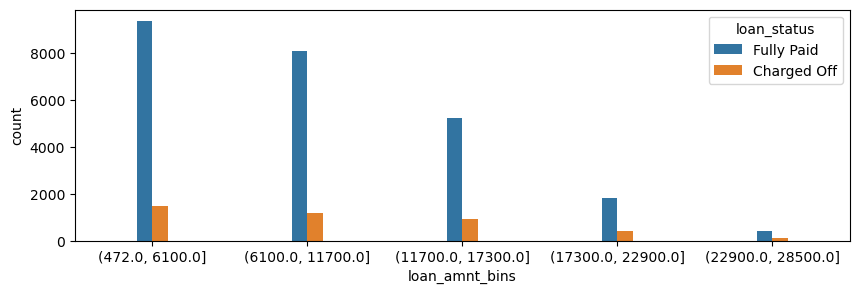

CountPlot of funded_amnt_bins


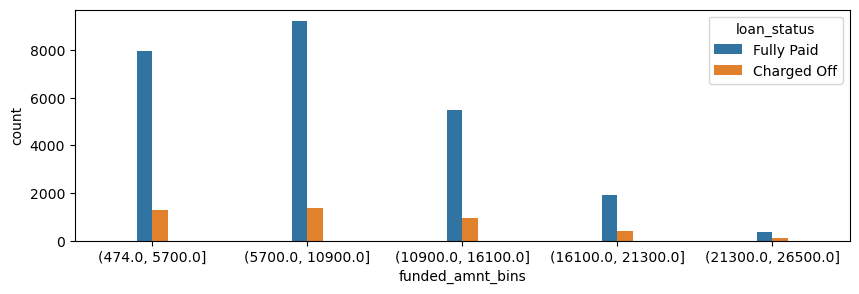

CountPlot of funded_amnt_inv_bins


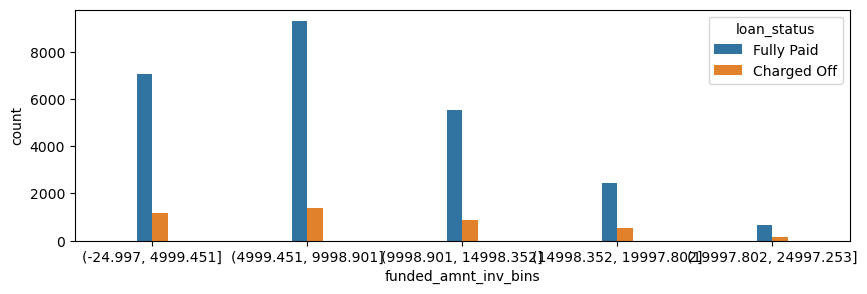

CountPlot of int_rate_bins


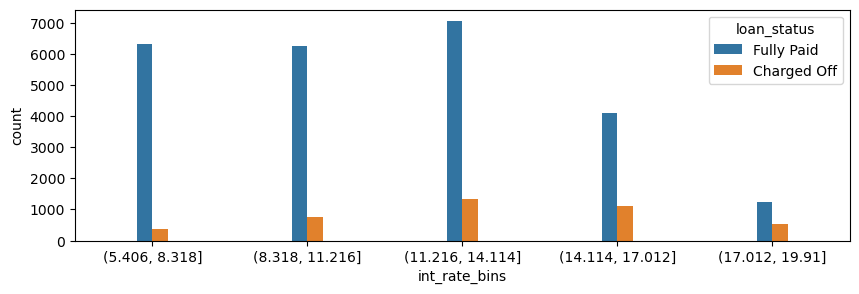

CountPlot of annual_inc_bins


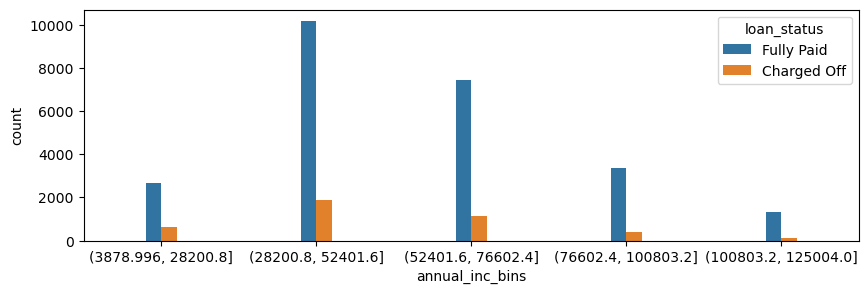

CountPlot of installment_bins


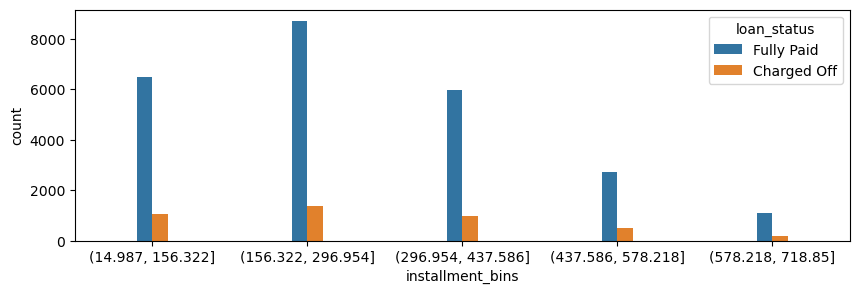

CountPlot of dti_bins


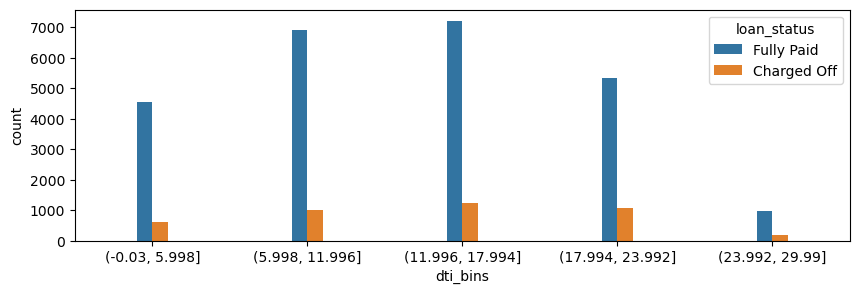

CountPlot of revol_bal_bins


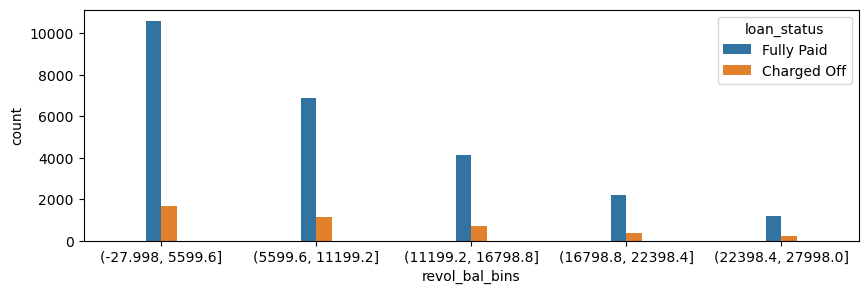

CountPlot of revol_util_bins


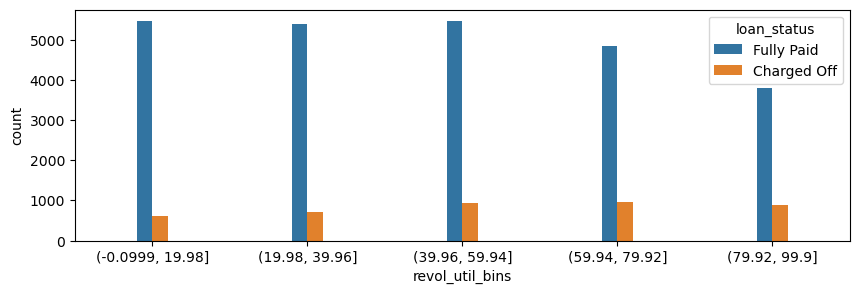

In [48]:
for i in num_bins:
    plt.figure(figsize = [10,3])
    print("CountPlot of", i)
    sns.countplot(x=loan[i].sort_values(ascending=True), width=0.2,hue=loan.loan_status)
    plt.show()

CountPlot of issued year


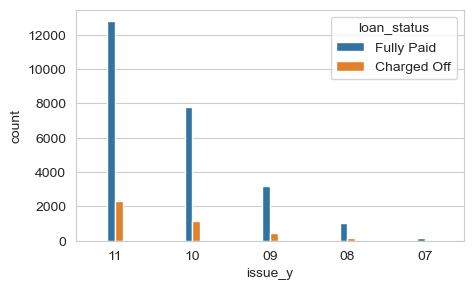

In [85]:
plt.figure(figsize = [5,3])
print("CountPlot of issued year")
sns.countplot(x=loan.issue_y, width=0.2,hue=loan.loan_status)
plt.show()

#### Observations from Univariate analysis of Numerical columns
<br>

- `Loan amount, under 11.7k has majority of defaulters`. Intermediate range has moderate defaulters and extensive range has fewer defaulters. 

<br>

- `Funded Amount, under 10.9k has majority of defaulters`. Intermediate range has moderate number of defaulters and extensive range has fewer defaulters. 

<br>

- `Funded Amount by investers, under 99.98k has majority of defaulters`. Intermediate range has moderate number of defaulters and extensive range has fewer defaulters. 

<br>

- `Interest Rates in between 11 to 17 has majority of defaulters`.

<br>

- `Annual income from 28.2k to 52.40k comprises majority of defaulters`. Under 28k and above 76k comprises moderate to fewe  of defaulters

<br>

- `Installment from 14.9 to 437 comprises majority of defaulters`. Above 437, There are moderate to fewer deafaulters.

<br>

- `DTI ratio from 11 to 17 comprises majority of defaulters`. Below and above ranges have moderate number of defaulters.

<br>

- `Revolving balance under 16.7k comprises majority of defaulters`. Above that range have moderate in number.

<br>

- `Revolving utilization from 39 to 99 comprises majority of Defaulters`. Below that range have moderate number of defaulters.

<br>

- `Issue year, Defaulted rate gets increased from 2007 to 2011. Majority of defaulters are in 2011`

## Univariate analysis on Categorical variables

CountPlot of term


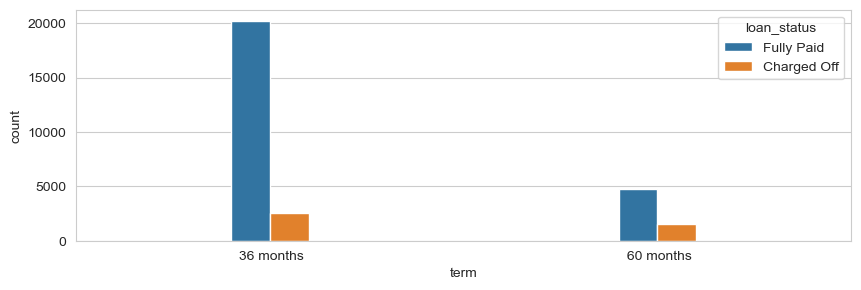

CountPlot of grade


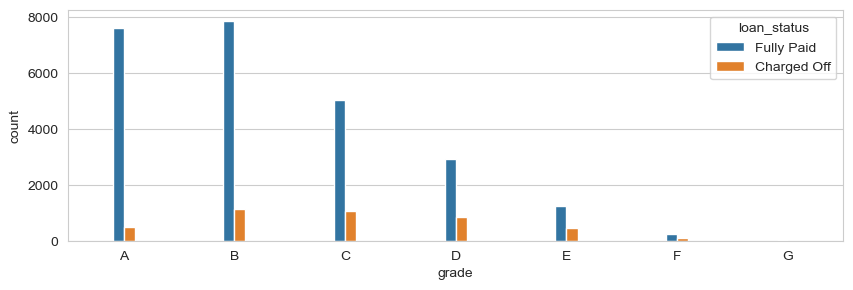

CountPlot of sub_grade


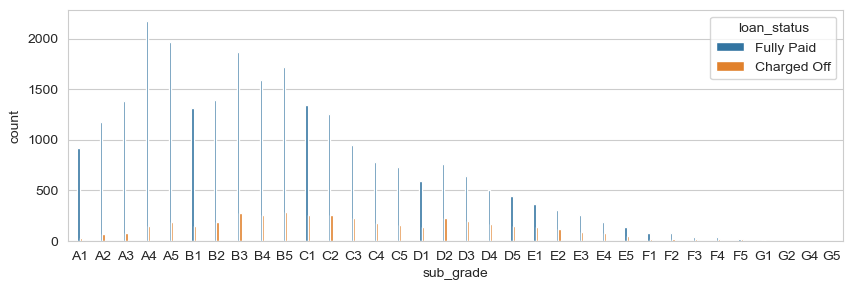

CountPlot of emp_length


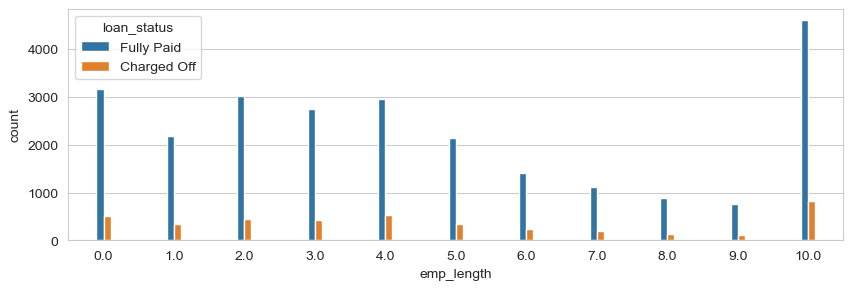

CountPlot of home_ownership


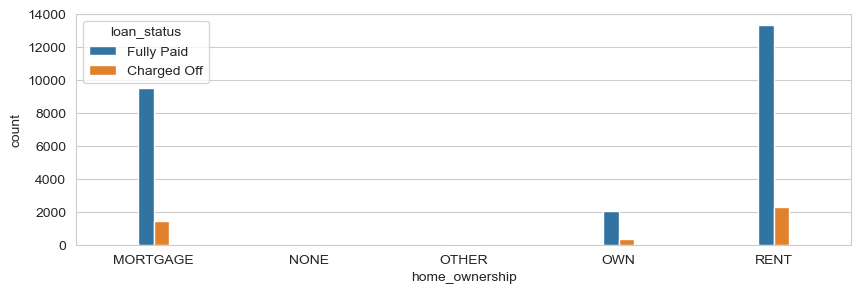

CountPlot of delinq_2yrs


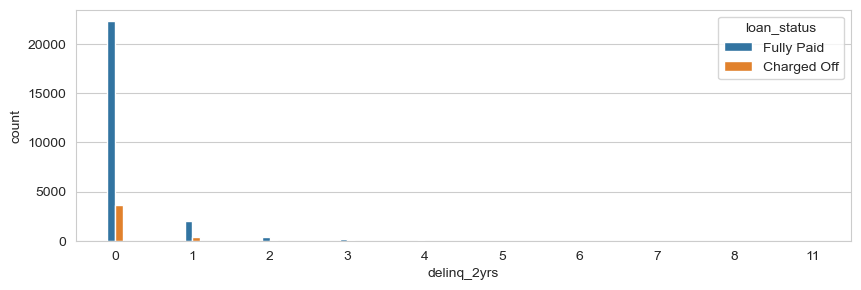

CountPlot of inq_last_6mths


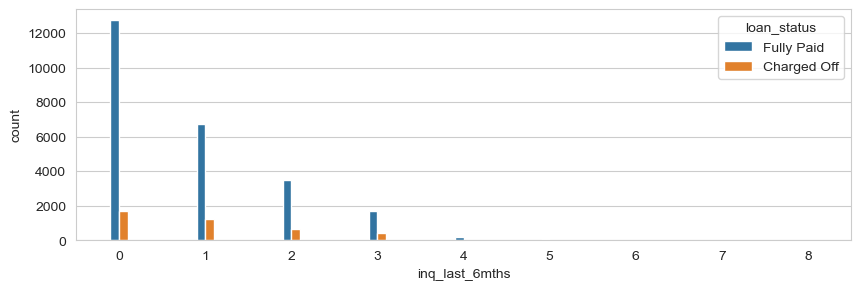

CountPlot of verification_status


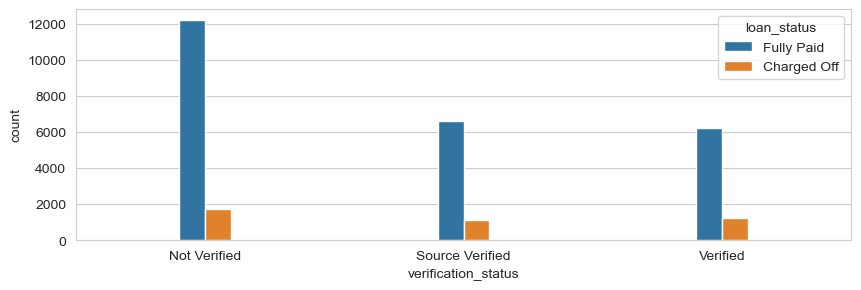

CountPlot of loan_status


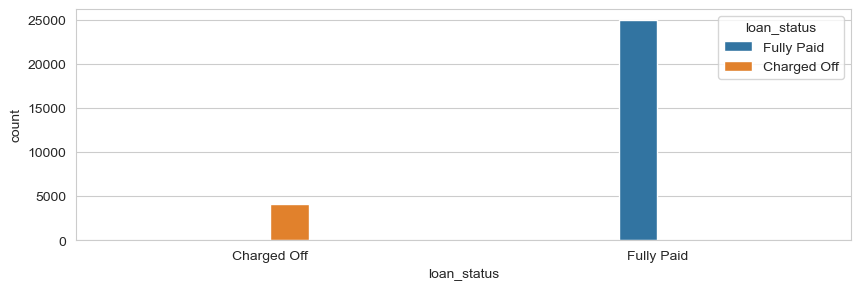

CountPlot of pub_rec


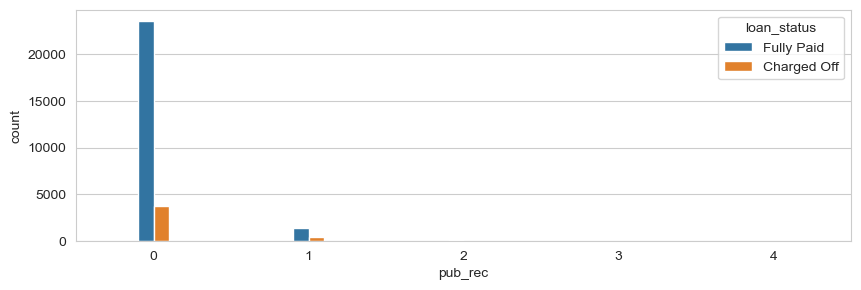

CountPlot of pub_rec_bankruptcies


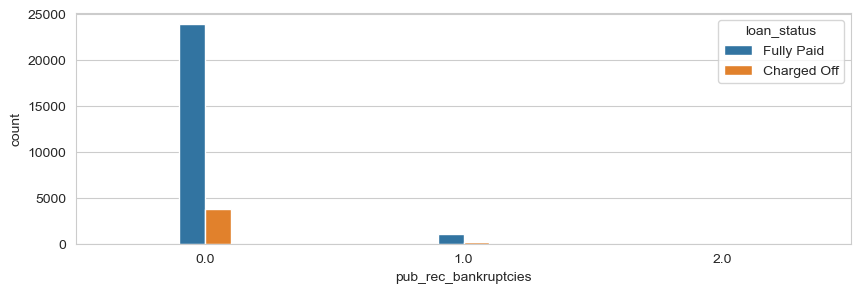

In [86]:
for i in ['term','grade','sub_grade', 'emp_length', 'home_ownership','delinq_2yrs','inq_last_6mths','verification_status',
        'loan_status','pub_rec', 'pub_rec_bankruptcies']:
    
    plt.figure(figsize = [10,3])
    print("CountPlot of", i)
    sns.countplot(x=loan[i].sort_values(ascending=True), width=0.2,hue=loan.loan_status)
    plt.show()

CountPlot of issued month


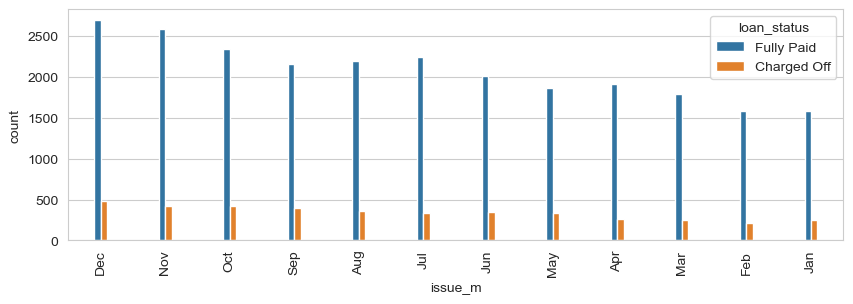

In [190]:
plt.figure(figsize = [10,3])
print("CountPlot of issued month")
sns.countplot(x=loan.issue_m, width=0.2,hue=loan.loan_status)
plt.xticks(rotation=90)
plt.show()

CountPlot of addr_state


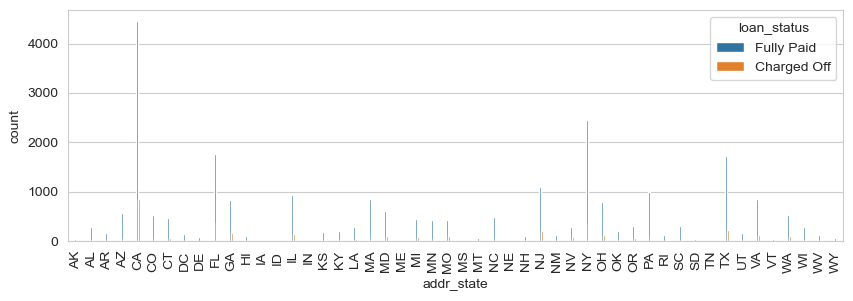

CountPlot of purpose


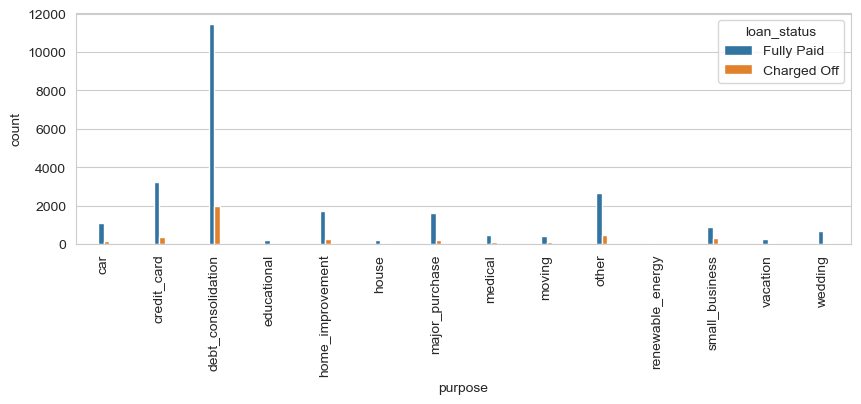

In [191]:
for i in ['addr_state', 'purpose']:
    plt.figure(figsize = [10,3])
    print("CountPlot of", i)
    sns.countplot(x=loan[i].sort_values(ascending=True), width=0.2,hue=loan.loan_status)
    plt.xticks(rotation=90)
    plt.show()

In [89]:
pd.crosstab(loan.sub_grade,loan.loan_status)

loan_status,Charged Off,Fully Paid
sub_grade,,
A1,25,920
A2,66,1176
A3,81,1378
A4,144,2176
A5,183,1966
B1,144,1309
B2,181,1387
B3,273,1867
B4,256,1591


In [90]:
pd.crosstab(loan.emp_length,loan.loan_status)

loan_status,Charged Off,Fully Paid
emp_length,,
0.0,507,3159
1.0,345,2193
2.0,448,3020
3.0,431,2758
4.0,540,2953
5.0,341,2135
6.0,232,1415
7.0,190,1115
8.0,135,884


In [91]:
pd.crosstab(loan.home_ownership,loan.loan_status)

loan_status,Charged Off,Fully Paid
home_ownership,,
MORTGAGE,1443,9544
NONE,0,3
OTHER,14,66
OWN,337,2020
RENT,2317,13357


In [92]:
pd.crosstab(loan.verification_status,loan.loan_status)

loan_status,Charged Off,Fully Paid
verification_status,,
Not Verified,1763,12181
Source Verified,1106,6606
Verified,1242,6203


In [93]:
pd.crosstab(loan.issue_m,loan.loan_status)

loan_status,Charged Off,Fully Paid
issue_m,,
Apr,266,1912
Aug,364,2195
Dec,487,2695
Feb,220,1583
Jan,252,1581
Jul,340,2248
Jun,349,2017
Mar,253,1789
May,341,1871


##### Observations Of Univariate analysis of Categorical Columns:
<br>

- `Term plan with 60months has higher defaulters than 30months`.  

<br>

- `Grades Among all, B comprises majority of Defaulters`. Then comes A,C,D,E,F,G grades.

<br>

- `Sub Grade B5 comprises majority of Defaulters`. B4,B3,B2,A5,B1,A1 has nearly high number of defaulters.

<br>

- `Employment Length with 10years comprises majority of defaulters`. 0 and 4years consists of moderate number of defaulters.

<br>

- `Home Ownership with rent and moratage has majority of defaulters`. Borrowers with Own home are less likely to get defaulted.

<br>

- `Verification Status, No source/annual income verification has majority of defaulters`. For Rest defaulters are moderate in number.

<br>

- `Loan Status For this loan dataset, chargeoff are lesser in number compared to fullypaid.`

<br>

- `Delinq_2yrs as 0 has majority of defaulters and moderate defaulters at 1`. Rest has fewer number of defaulters.

<br>

- `Inquiry in last 6 months, 0 to 1 inquiry comprises majority of defaulters`. Rest has moderate to fewer number of defaulters

<br>

- `Pubic records as 0 has majority of defaulters and moderate defaulters at 1`. Rest has fewer number of defaulters.

<br>

- `Public record bankruptcies as 0 has majority of defaulters and moderate defaulters at 1`. Rest has fewer number of defaulters.

<br>

- `Issue Month, year ending months comprises majority of defaulters`.

<br>

- `Purpose of loan as Debt consolidation has majority of defaulters`.

<br>

- `Address state as california, florida and new york consists majority of defaulters`.(considering it has US loan dataset set)




### Numerical cols vs Charged Off 
###### For Better understanding of data lets plot each numerical column for charged off.

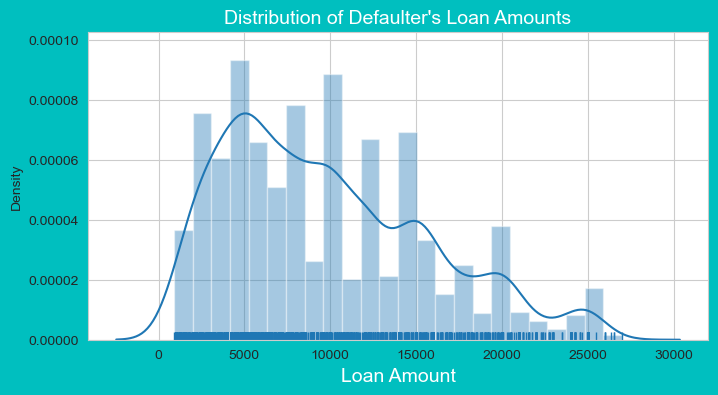

In [95]:
charged_off = loan[loan.loan_status == 'Charged Off']

plt.figure(figsize=(8,4),facecolor='c')
sns.set_style("whitegrid")

ax = sns.distplot(charged_off['loan_amnt'],rug = True)
ax.set_title('Distribution of Defaulter\'s Loan Amounts',fontsize=14,color='w')
ax.set_xlabel('Loan Amount',fontsize=14,color='w')
plt.show()

Text(0.5, 0, 'Funded Amounts')

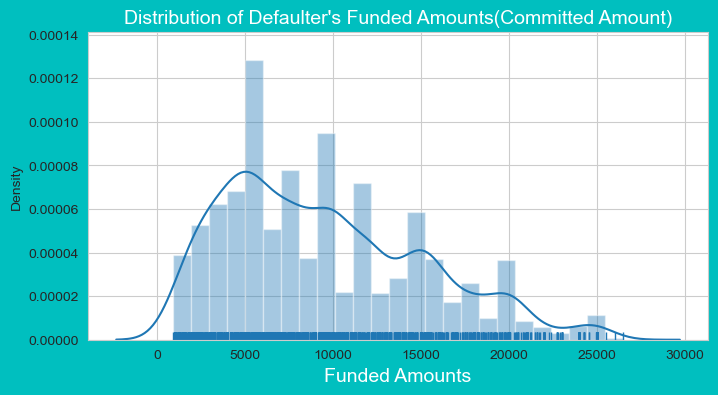

In [96]:
plt.figure(figsize=(8,4),facecolor='c')
sns.set_style("whitegrid")

ax = sns.distplot(charged_off['funded_amnt'],rug = True)
ax.set_title('Distribution of Defaulter\'s Funded Amounts(Committed Amount)',fontsize=14,color='w')
ax.set_xlabel('Funded Amounts',fontsize=14,color='w')

Text(0.5, 0, 'Funded amount by investers')

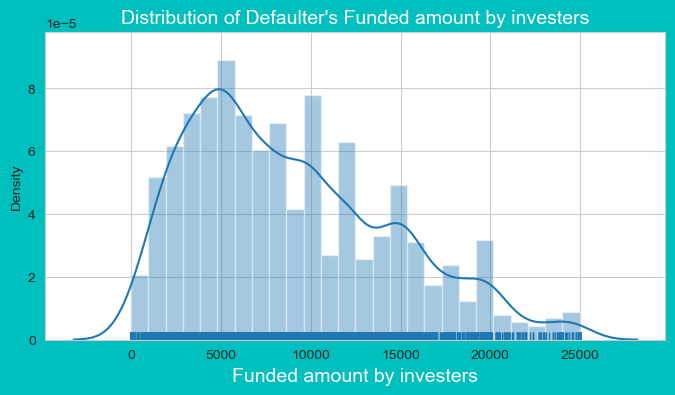

In [97]:
plt.figure(figsize=(8,4),facecolor='c')
sns.set_style("whitegrid")

ax = sns.distplot(charged_off['funded_amnt_inv'],rug = True)
ax.set_title('Distribution of Defaulter\'s Funded amount by investers',fontsize=14,color='w')
ax.set_xlabel('Funded amount by investers',fontsize=14,color='w')

Text(0.5, 0, 'Interest Rates')

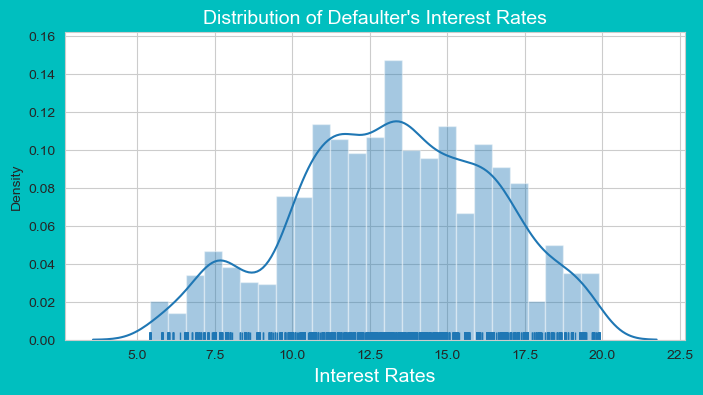

In [98]:
plt.figure(figsize=(8,4),facecolor='c')
sns.set_style("whitegrid")

ax = sns.distplot(charged_off['int_rate'],rug = True)
ax.set_title('Distribution of Defaulter\'s Interest Rates',fontsize=14,color='w')
ax.set_xlabel('Interest Rates',fontsize=14,color='w')

Text(0.5, 0, 'Installment')

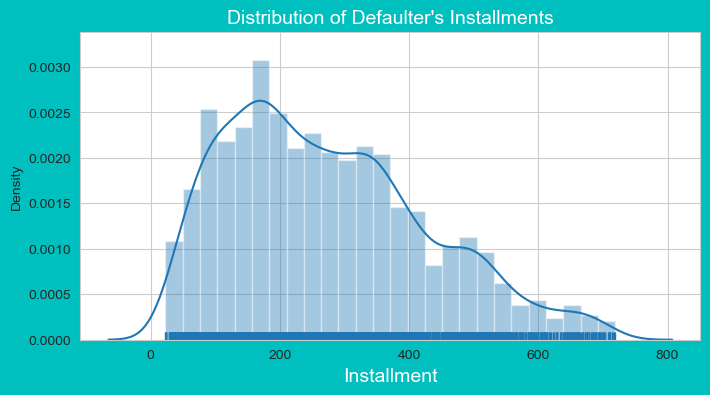

In [99]:
plt.figure(figsize=(8,4),facecolor='c')
sns.set_style("whitegrid")

ax = sns.distplot(charged_off['installment'],rug = True)
ax.set_title('Distribution of Defaulter\'s Installments',fontsize=14,color='w')
ax.set_xlabel('Installment',fontsize=14,color='w')

Text(0.5, 0, 'Annual Income')

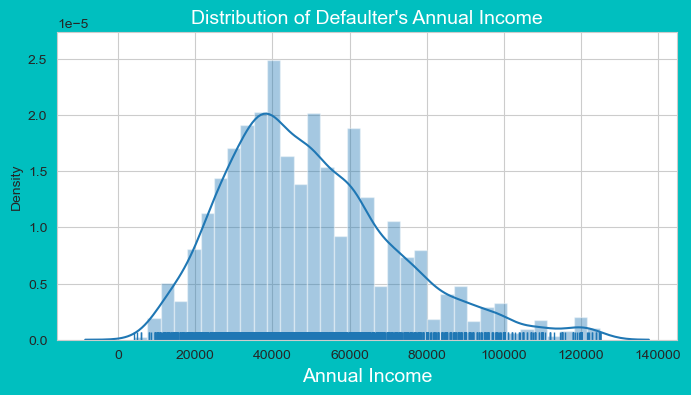

In [100]:
plt.figure(figsize=(8,4),facecolor='c')
sns.set_style("whitegrid")

ax = sns.distplot(charged_off['annual_inc'],rug = True)
ax.set_title('Distribution of Defaulter\'s Annual Income',fontsize=14,color='w')
ax.set_xlabel('Annual Income',fontsize=14,color='w')

Text(0.5, 0, 'DTI')

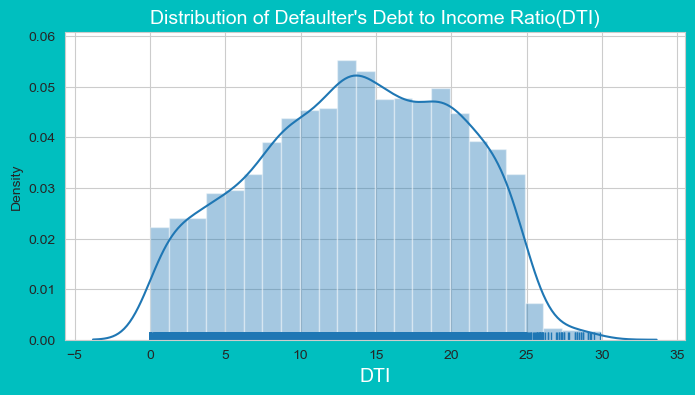

In [101]:
plt.figure(figsize=(8,4),facecolor='c')
sns.set_style("whitegrid")

ax = sns.distplot(charged_off['dti'],rug = True)
ax.set_title('Distribution of Defaulter\'s Debt to Income Ratio(DTI)',fontsize=14,color='w')
ax.set_xlabel('DTI',fontsize=14,color='w')

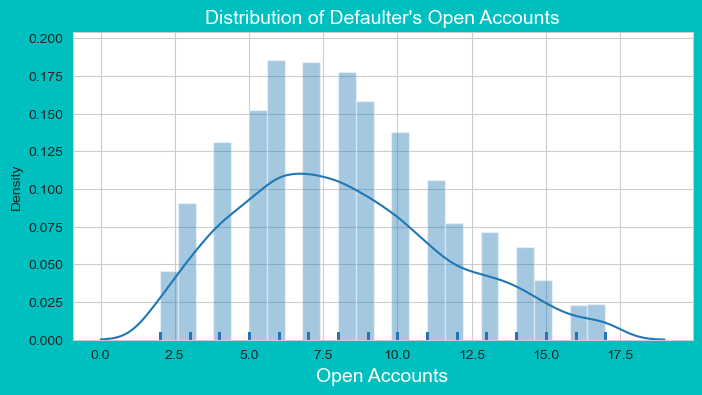

In [102]:
plt.figure(figsize=(8,4),facecolor='c')
sns.set_style("whitegrid")

ax = sns.distplot(charged_off['open_acc'],rug = True)
ax.set_title('Distribution of Defaulter\'s Open Accounts',fontsize=14,color='w')
ax.set_xlabel('Open Accounts',fontsize=14,color='w')
plt.show()

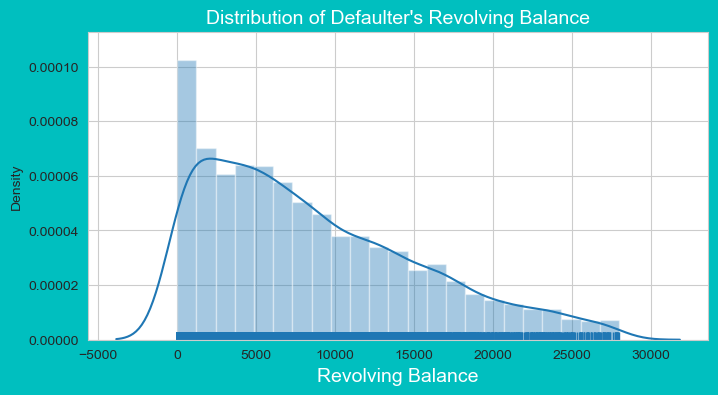

In [103]:
plt.figure(figsize=(8,4),facecolor='c')
sns.set_style("whitegrid")

ax = sns.distplot(charged_off['revol_bal'],rug = True)
ax.set_title('Distribution of Defaulter\'s Revolving Balance',fontsize=14,color='w')
ax.set_xlabel('Revolving Balance',fontsize=14,color='w')
plt.show()

Text(0.5, 0, 'Revolving Utility')

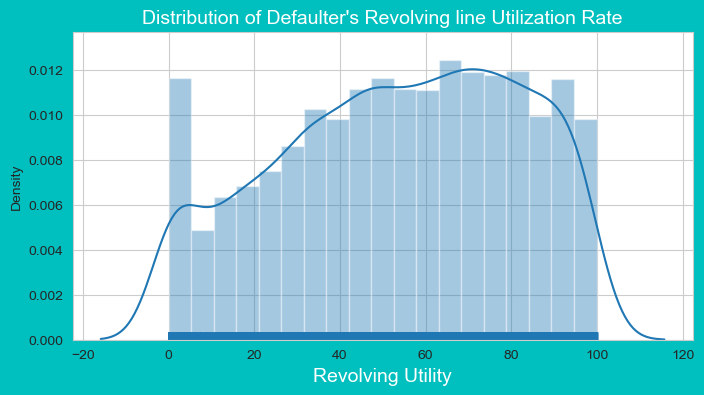

In [104]:
plt.figure(figsize=(8,4),facecolor='c')
sns.set_style("whitegrid")

ax = sns.distplot(charged_off['revol_util'],rug = True)
ax.set_title('Distribution of Defaulter\'s Revolving line Utilization Rate',fontsize=14,color='w')
ax.set_xlabel('Revolving Utility',fontsize=14,color='w')

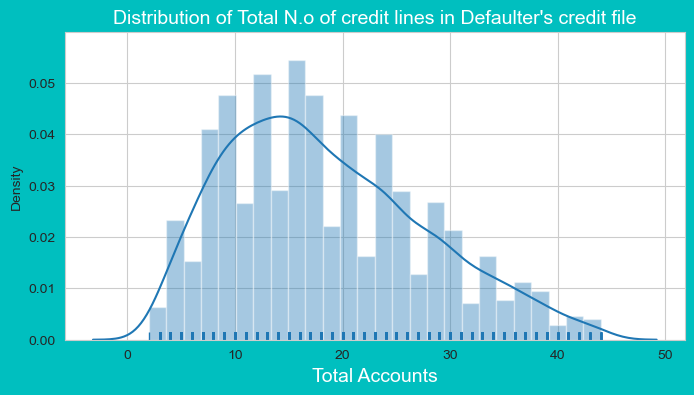

In [105]:
plt.figure(figsize=(8,4),facecolor='c')
sns.set_style("whitegrid")

ax = sns.distplot(charged_off['total_acc'],rug = True)
ax.set_title('Distribution of Total N.o of credit lines in Defaulter\'s credit file',fontsize=14,color='w')
ax.set_xlabel('Total Accounts',fontsize=14,color='w')
plt.show()

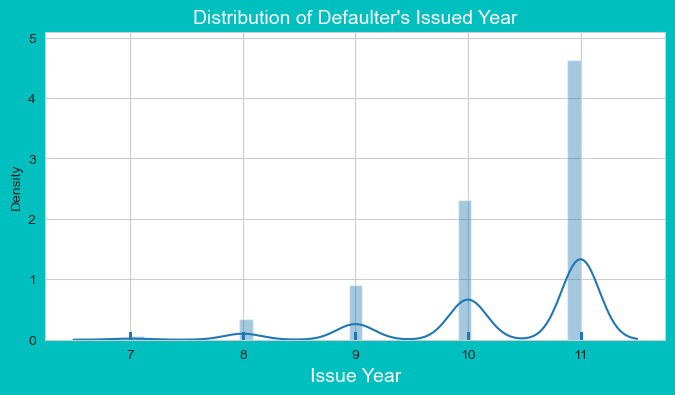

In [106]:
plt.figure(figsize=(8,4),facecolor='c')
sns.set_style("whitegrid")

ax = sns.distplot(charged_off['issue_y'],rug = True)
ax.set_title('Distribution of Defaulter\'s Issued Year',fontsize=14,color='w')
ax.set_xlabel('Issue Year',fontsize=14,color='w')
plt.show()

#### Observations From Numerical Columns:
<br>

- <font color='brown'>Lesser Annual Income/Loan amount, Higher chance of Defaulters</font>.

<br>

- <font color='brown'>Higher Interest Rates,Higher chance of Defaulters</font>.

<br>

- <font color='brown'>Higher dti, Higher chance of Defaulter</font>.

<br>

- <font color='brown'>Lesser Revolving Balance, Higher chance of Defaulters</font>.

<br>

- <font color='brown'>Higher Revolving line utilization rate, Higher Chance of Defaulter</font>.

<br>

- <font color='brown'>Year 2011 has High number of Defaulters</font>.

<br>

### Categorical cols vs charged off

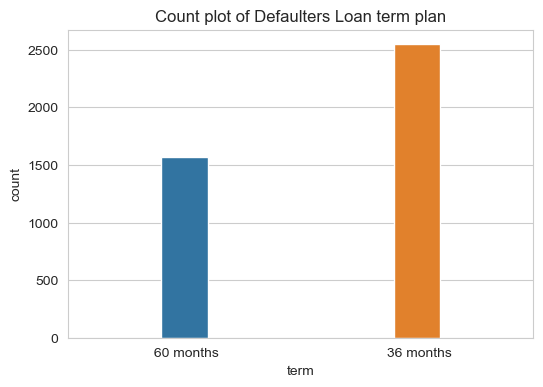

In [107]:
plt.figure(figsize = [6,4])
sns.countplot(x='term', data=charged_off, width=0.2)
plt.title('Count plot of Defaulters Loan term plan')
plt.show()

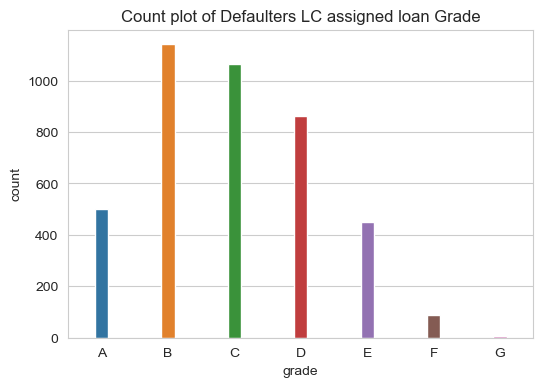

In [108]:
plt.figure(figsize = [6,4])
sns.countplot(x='grade', data=charged_off, width=0.2, order = ['A','B','C','D','E','F','G'])
plt.title('Count plot of Defaulters LC assigned loan Grade')
plt.show()

In [109]:
pd.crosstab(loan.grade,loan.loan_status)

loan_status,Charged Off,Fully Paid
grade,,
A,499,7616
B,1141,7877
C,1066,5056
D,861,2934
E,450,1241
F,88,254
G,6,12


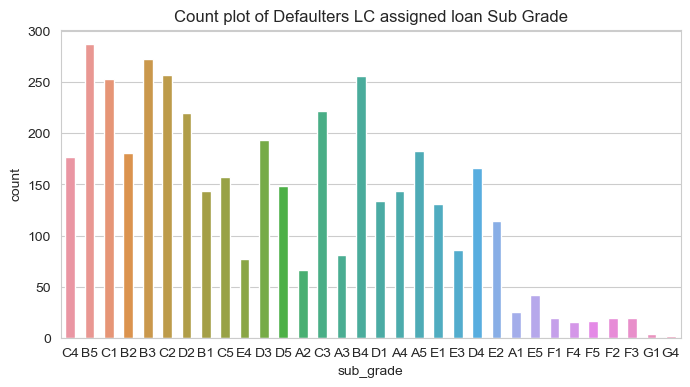

In [110]:
plt.figure(figsize = [8,4])
sns.countplot(x='sub_grade', data=charged_off, width=0.5)
plt.title('Count plot of Defaulters LC assigned loan Sub Grade')
plt.show()

In [111]:
pd.crosstab(charged_off.sub_grade,charged_off.loan_status)[:10]

loan_status,Charged Off
sub_grade,
A1,25
A2,66
A3,81
A4,144
A5,183
B1,144
B2,181
B3,273
B4,256


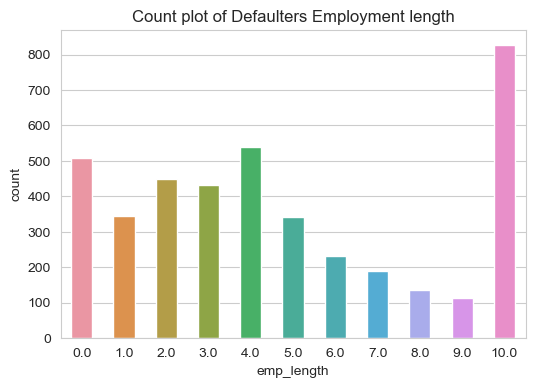

In [112]:
plt.figure(figsize = [6,4])
sns.countplot(x='emp_length', data=charged_off, width=0.5)
plt.title('Count plot of Defaulters Employment length')
plt.show()

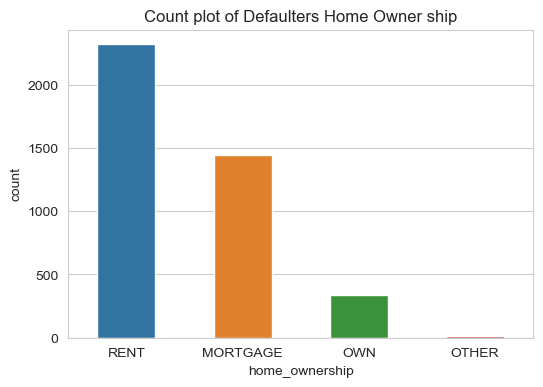

In [113]:
plt.figure(figsize = [6,4])
sns.countplot(x='home_ownership', data=charged_off, width=0.5)
plt.title('Count plot of Defaulters Home Owner ship')
plt.show()

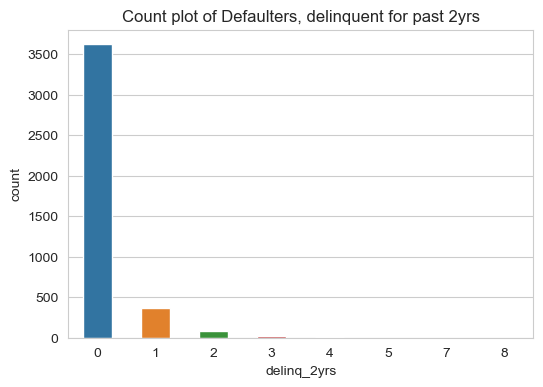

In [114]:
plt.figure(figsize = [6,4])
sns.countplot(x='delinq_2yrs', data=charged_off, width=0.5)
plt.title('Count plot of Defaulters, delinquent for past 2yrs')
plt.show()

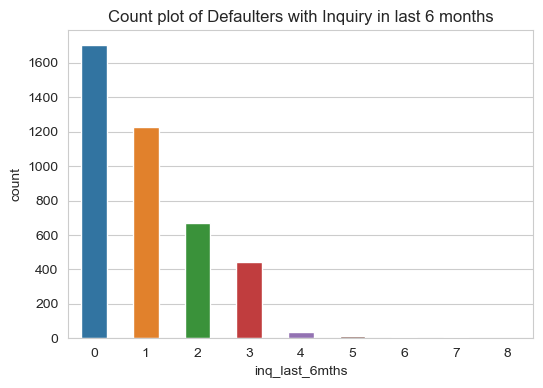

In [115]:
plt.figure(figsize = [6,4])
sns.countplot(x='inq_last_6mths', data=loan[loan.loan_status == 'Charged Off'], width=0.5)
plt.title('Count plot of Defaulters with Inquiry in last 6 months')
plt.show()

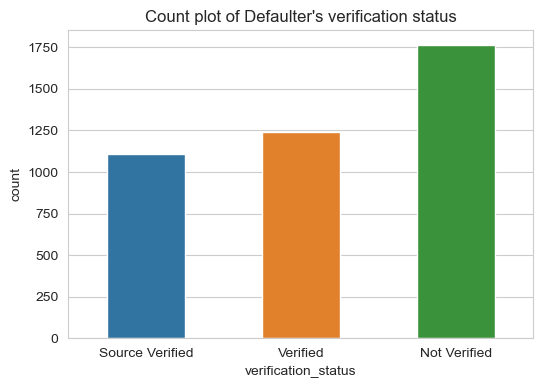

In [116]:
plt.figure(figsize = [6,4])
sns.countplot(x='verification_status', data=charged_off, width=0.5)
plt.title('Count plot of Defaulter\'s verification status' )
plt.show()

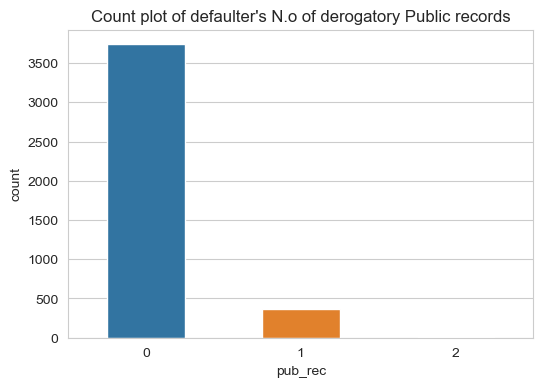

In [117]:
plt.figure(figsize = [6,4])
sns.countplot(x='pub_rec',data=charged_off, width=0.5)
plt.title('Count plot of defaulter\'s N.o of derogatory Public records')
plt.show()

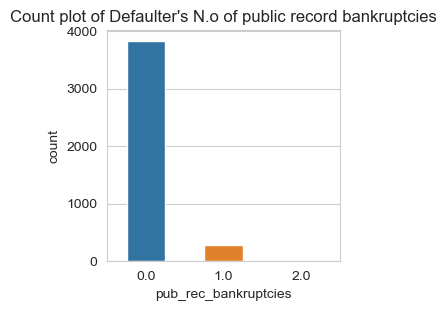

In [118]:
plt.figure(figsize = [3,3])
sns.countplot(x='pub_rec_bankruptcies', data=charged_off, width=0.5)
plt.title('Count plot of Defaulter\'s N.o of public record bankruptcies')
plt.show()

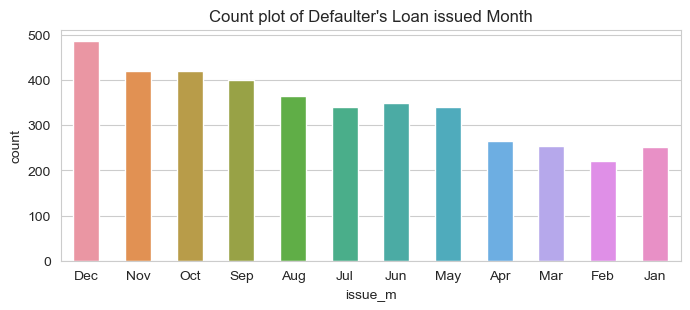

In [119]:
plt.figure(figsize = [8,3])
sns.countplot(x='issue_m', data=loan[loan.loan_status == 'Charged Off'], width=0.5)
plt.title('Count plot of Defaulter\'s Loan issued Month')
plt.show()

#### Observations from Categorical Columns:
<br>

- <font color='brown'>Lesser the Term plan, High the chance of Defaulters</font>.

<br>

- <font color='brown'>Grade B has Higher Defaulters</font>.

<br>

- <font color='brown'>Sub grade B5 has higher Defaulters</font>.

<br>

- <font color='brown'>Rented Home borrowers are likely to become Defaulters</font>.

<br>

- <font color='brown'>No Inquiries in last 6 months likely to become Defaulters</font>.

<br>

- <font color='brown'>Borrowers with No Source/Annual Income verification likely to become Defaulters</font>.

<br>

- <font color='brown'>Year End has Higher Defaulters</font>.


## Bivariate Analysis

#### Numerical vs loan_status(Fully paid and Charged Off)

Boxplot of Loan_status and loan_amnt


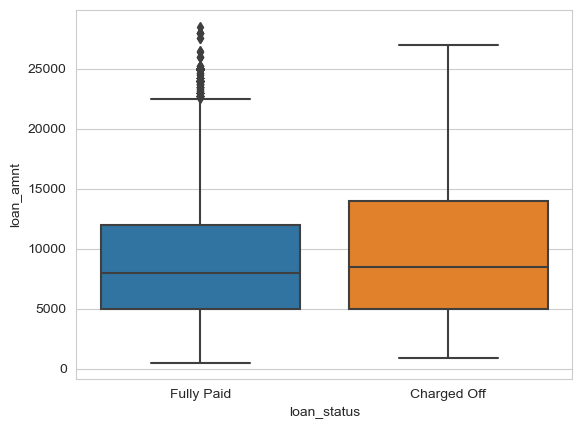

Boxplot of Loan_status and funded_amnt


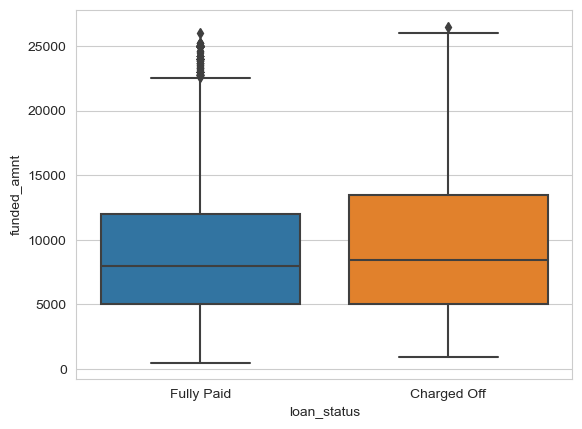

Boxplot of Loan_status and funded_amnt_inv


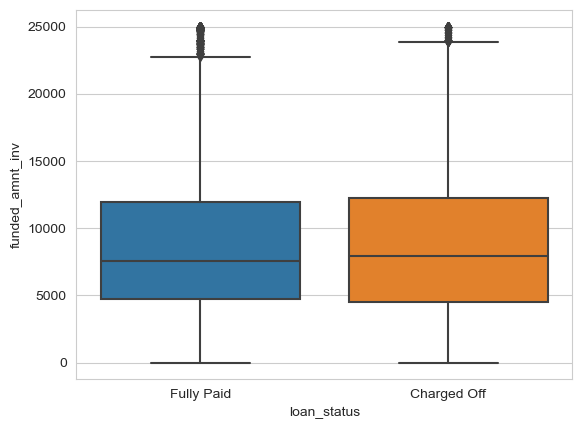

Boxplot of Loan_status and int_rate


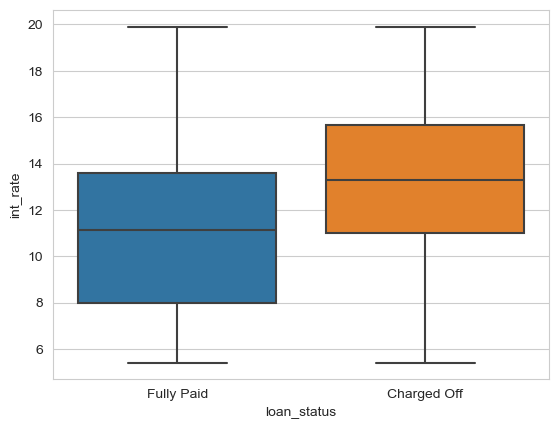

Boxplot of Loan_status and installment


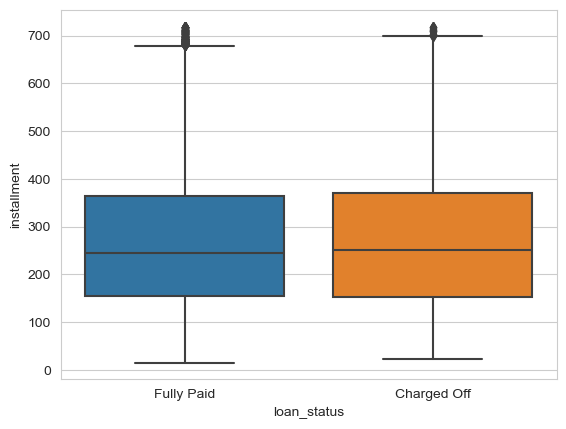

Boxplot of Loan_status and annual_inc


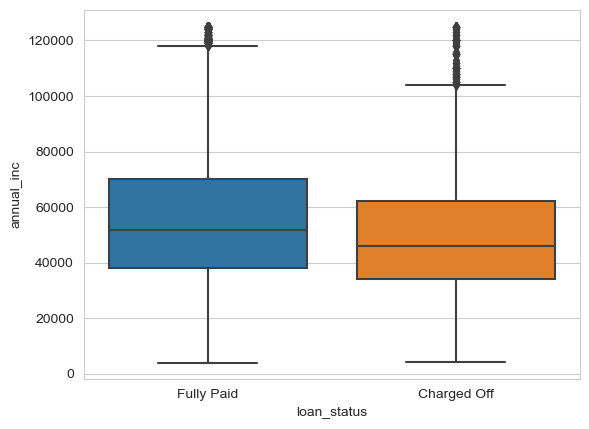

Boxplot of Loan_status and dti


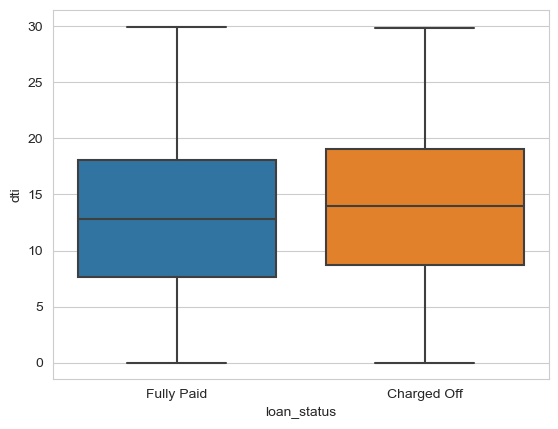

Boxplot of Loan_status and open_acc


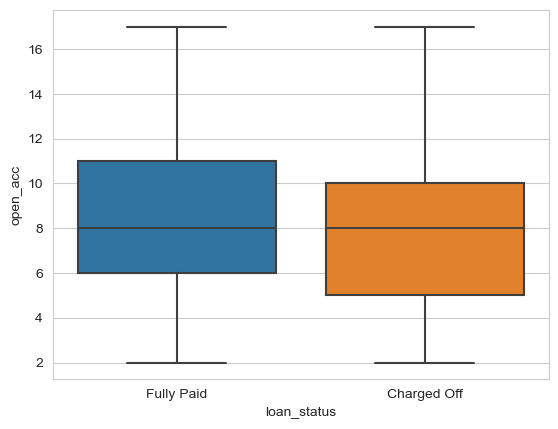

Boxplot of Loan_status and revol_bal


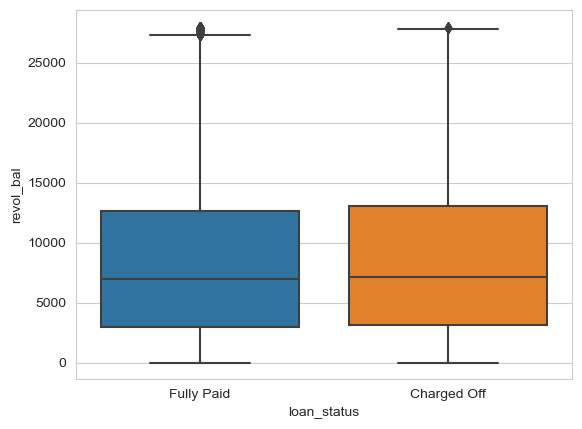

Boxplot of Loan_status and revol_util


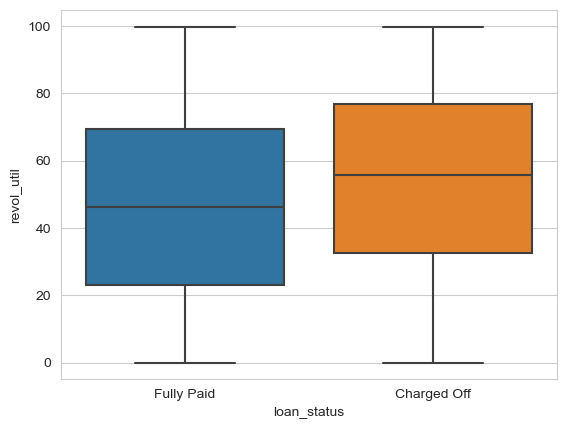

Boxplot of Loan_status and total_acc


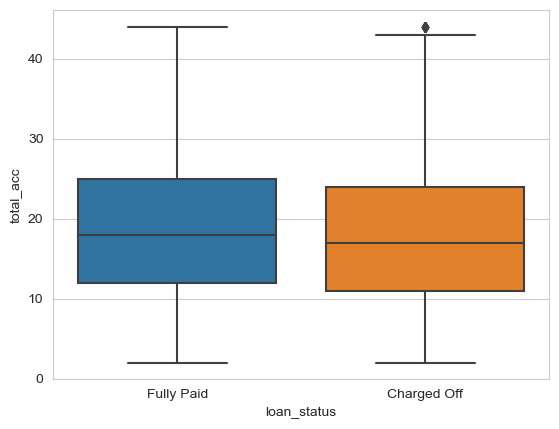

In [94]:
for i in ['loan_amnt', 'funded_amnt', 'funded_amnt_inv', 'int_rate', 'installment', 'annual_inc', 'dti', 'open_acc', 'revol_bal', 'revol_util', 'total_acc']:
    print('Boxplot of Loan_status and',i)
    sns.boxplot(x=loan.loan_status,y=loan[i])
    plt.show()

#### Observations: Loan status vs numerical columns

- Loan_amnt: `More defaulters lies between loan amount 5000 to 27000`.spread of defaulters is more than fully paid borrowers.75% quartile is higher for defaulters when compared to fully paid borrowers.
- Funded_amnt: Similar to loan amount.
- Funded_amnt_inv: Fully paid and charged off are almost similar.
- int_rate : `More the interest rates leads to more defaulters`. 25% of defaulters had interest rates below 12 which is equal to 50% of fully paid borrowers and 75% of defaulters falls under interest rate 15, Which is greater than 75% of fully paid borrowers.
- installment : `More defaulters lies under installment from 50 to 690`
- annual_inc : 50% of defaulters falls under 50,000 annual income. 75% of defaulters falls under 60,000 annual income.`Defaulters falls under 35000 to 1 lalkh `. Spread of defaulters is less compared to fully paid borrowers.
- dti : `Spread of defaulters lies between 9 to 19 dti`. Whereas fully paid falls under 7 and 18 of dti. `Higher dti leads to more defaulters`.
- open_acc: 50% of defaulters falls under 8 open accounts.75% of defaulters falls under 10 open accounts.`lesser open accounts between 5 and 8 have more defaulters`.
- revol_bal : Charged off are equal in count with fully paid borrowers.
- revol_util : `Spread of defaulters is more for utility rate under 30 to 70`
- total_acc :  `Spread of defaulters is more for total_acc under 12 to 25`


Charged_off has data of only chargedoff borrowers creating numerical bins for chargedoff dataframe

In [74]:
charged_off['loan_amnt_bins'] = loan['loan_amnt_bins']
charged_off['int_rate_bins'] = loan['int_rate_bins']
charged_off['annual_inc_bins'] = loan['annual_inc_bins']
charged_off['dti_bins'] = loan['dti_bins']
charged_off['revol_bal_bins'] = loan['revol_bal_bins']
charged_off['revol_util_bins'] = loan['revol_util_bins']
charged_off['installment_bins'] = loan['installment_bins']


<font color='blue'>Loan amount vs Grade</font>

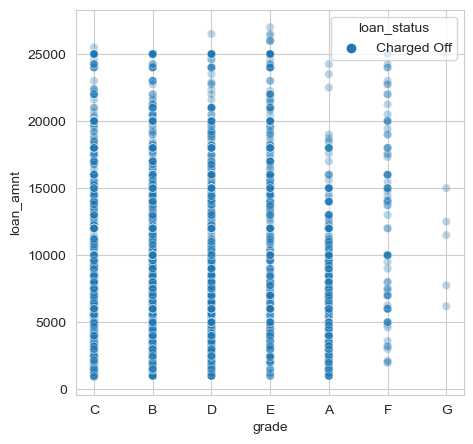

In [219]:
plt.figure(figsize = [5,5])
sns.scatterplot(y= 'loan_amnt',x='grade', data=charged_off, hue='loan_status', alpha=0.3)
plt.show()

<font color='purple'>Grades B,C & D Has high number of Defaulters</font>

In [121]:
charged_off[['loan_amnt_bins','grade','loan_status']].value_counts()[:6]

loan_amnt_bins     grade  loan_status
(472.0, 6100.0]    B      Charged Off    424
                   C      Charged Off    410
(6100.0, 11700.0]  B      Charged Off    334
                   C      Charged Off    293
(472.0, 6100.0]    D      Charged Off    273
(6100.0, 11700.0]  D      Charged Off    255
Name: count, dtype: int64

<font color='blue'>Loan amount vs Sub grade</font>

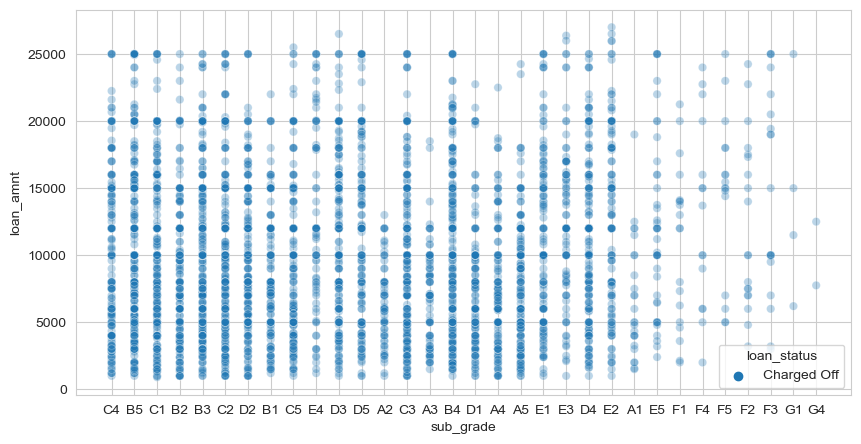

In [217]:
plt.figure(figsize = [10,5])
sns.scatterplot(y= 'loan_amnt',x='sub_grade', data=charged_off, hue='loan_status',alpha=0.3)
plt.show()

<font color='purple'>Sub grades B3,B5,C1,B4,C2,A5 has higher number of Defaulters</font>

In [220]:
charged_off[['loan_amnt_bins','sub_grade','loan_status']].value_counts()[:7]

loan_amnt_bins     sub_grade  loan_status
(472.0, 6100.0]    B3         Charged Off    106
                   B5         Charged Off    103
                   C1         Charged Off    101
                   B4         Charged Off     90
                   C2         Charged Off     90
                   A5         Charged Off     85
(6100.0, 11700.0]  C2         Charged Off     84
Name: count, dtype: int64

<font color='blue'>Loan amount vs Verification status</font>

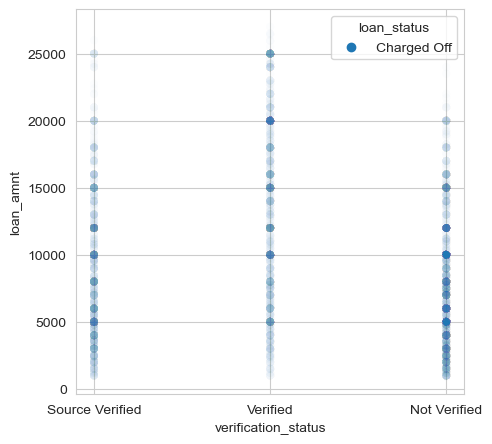

In [221]:
plt.figure(figsize = [5,5])
sns.scatterplot(y= 'loan_amnt',x='verification_status', data=charged_off,hue='loan_status', alpha=0.01)
plt.show()

<font color='purple'>No source/Income verificatioin has high Defaulters

In [222]:
charged_off[['loan_amnt_bins','verification_status','loan_status']].value_counts()[:1]

loan_amnt_bins   verification_status  loan_status
(472.0, 6100.0]  Not Verified         Charged Off    781
Name: count, dtype: int64

<font color='blue'>Loan amount vs Employment length</font>

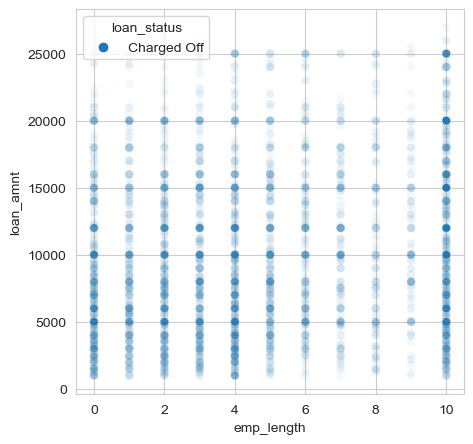

In [223]:
plt.figure(figsize = [5,5])
sns.scatterplot(y= 'loan_amnt',x='emp_length', data=charged_off,hue='loan_status', alpha=0.05)
plt.show()

<font color='purple'>Employment length within 4/0/10yrs has high number of defaulters.

In [224]:
charged_off[['loan_amnt_bins','emp_length','loan_status']].value_counts()[:5]

loan_amnt_bins      emp_length  loan_status
(472.0, 6100.0]     4.0         Charged Off    232
                    0.0         Charged Off    227
                    10.0        Charged Off    224
(11700.0, 17300.0]  10.0        Charged Off    223
(6100.0, 11700.0]   10.0        Charged Off    221
Name: count, dtype: int64

<font color='blue'>Loan amount vs revolving balance</font>

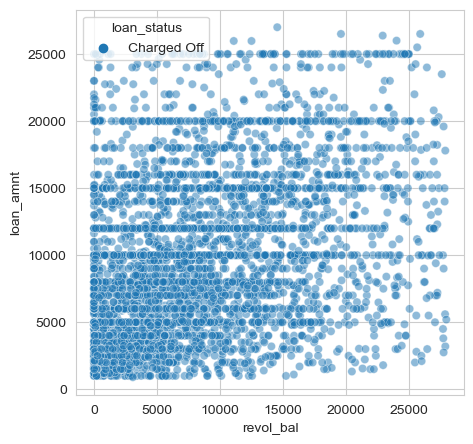

In [225]:
plt.figure(figsize = [5,5])
sns.scatterplot(y= 'loan_amnt',x='revol_bal', data=charged_off,hue='loan_status', alpha=0.5)
plt.show()

<font color='purple'>Lower Revolving balance with loan amount under 10k has higher Defaulters

<font color='blue'>Loan amount vs Revolving Utility</font>

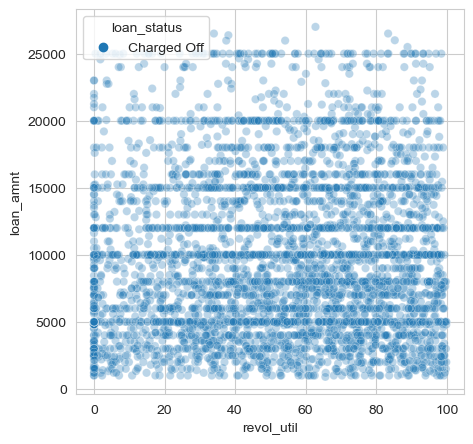

In [226]:
plt.figure(figsize = [5,5])
sns.scatterplot(y= 'loan_amnt',x='revol_util', data=charged_off,hue='loan_status', alpha=0.3)
plt.show()

<font color='purple'>Higher the Revolving utility wtih loan amount under 15k has higher number of defaulters

<font color='blue'>Loan amount vs Home Ownership</font>

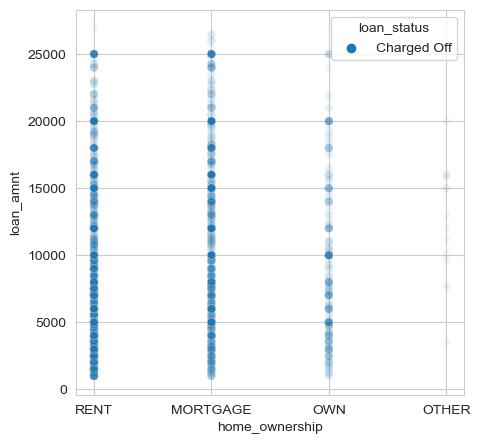

In [227]:
plt.figure(figsize = [5,5])
sns.scatterplot(y= 'loan_amnt',x='home_ownership', data=charged_off,hue='loan_status', alpha=0.05)
plt.show()

<font color='purple'>Rented house Borrowers under 17.3k loan amount are likely to become of Defaulters.

In [228]:
charged_off[['loan_amnt_bins','home_ownership','loan_status']].value_counts()[:4]

loan_amnt_bins      home_ownership  loan_status
(472.0, 6100.0]     RENT            Charged Off    928
(6100.0, 11700.0]   RENT            Charged Off    703
(11700.0, 17300.0]  RENT            Charged Off    449
                    MORTGAGE        Charged Off    412
Name: count, dtype: int64

<font color='blue'>Loan amount vs Interest Rate</font>

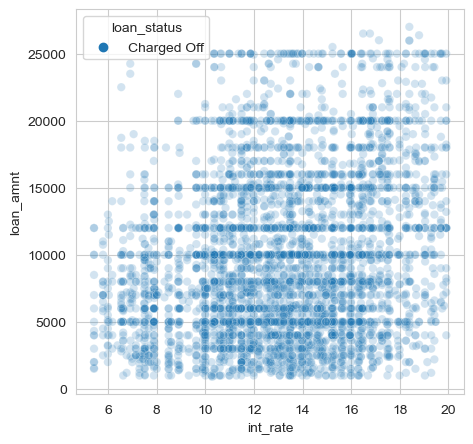

In [230]:
plt.figure(figsize = [5,5])
sns.scatterplot(y= 'loan_amnt',x='int_rate', data=charged_off, hue='loan_status', alpha=0.2)
plt.show()

<font color='purple'>Borrower's under loan amount under 17k, Interest rates from 8 to 13.49 are likely to become defaulters

In [231]:
charged_off[['loan_amnt_bins','int_rate','loan_status']].value_counts()[:5]

loan_amnt_bins      int_rate  loan_status
(472.0, 6100.0]     10.99     Charged Off    40
                    11.49     Charged Off    40
                    13.49     Charged Off    32
(11700.0, 17300.0]  13.49     Charged Off    28
(472.0, 6100.0]     8.49      Charged Off    24
Name: count, dtype: int64

<font color='blue'>Loan amount vs Purpose</font>

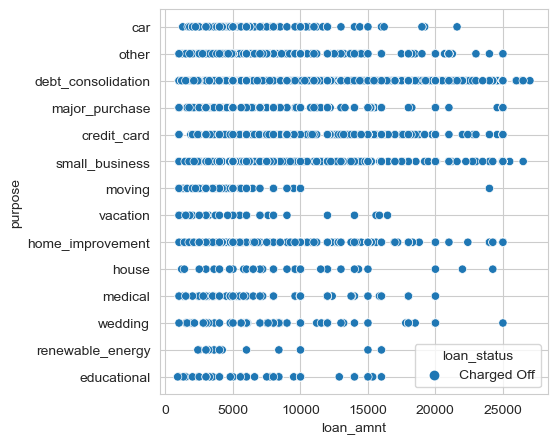

In [232]:
plt.figure(figsize = [5,5])
sns.scatterplot(x= 'loan_amnt',y='purpose', data=charged_off, hue='loan_status')
plt.show()

<font color='purple'>Borrower's Loan purpose as Debt consolidation with loan amount under 23k are likely to become defaulters

In [233]:
charged_off[['loan_amnt_bins','purpose','loan_status']].value_counts()[:5]

loan_amnt_bins      purpose             loan_status
(6100.0, 11700.0]   debt_consolidation  Charged Off    604
(11700.0, 17300.0]  debt_consolidation  Charged Off    544
(472.0, 6100.0]     debt_consolidation  Charged Off    512
                    other               Charged Off    295
(17300.0, 22900.0]  debt_consolidation  Charged Off    249
Name: count, dtype: int64

<font color='blue'>Loan amount vs Address State</font>

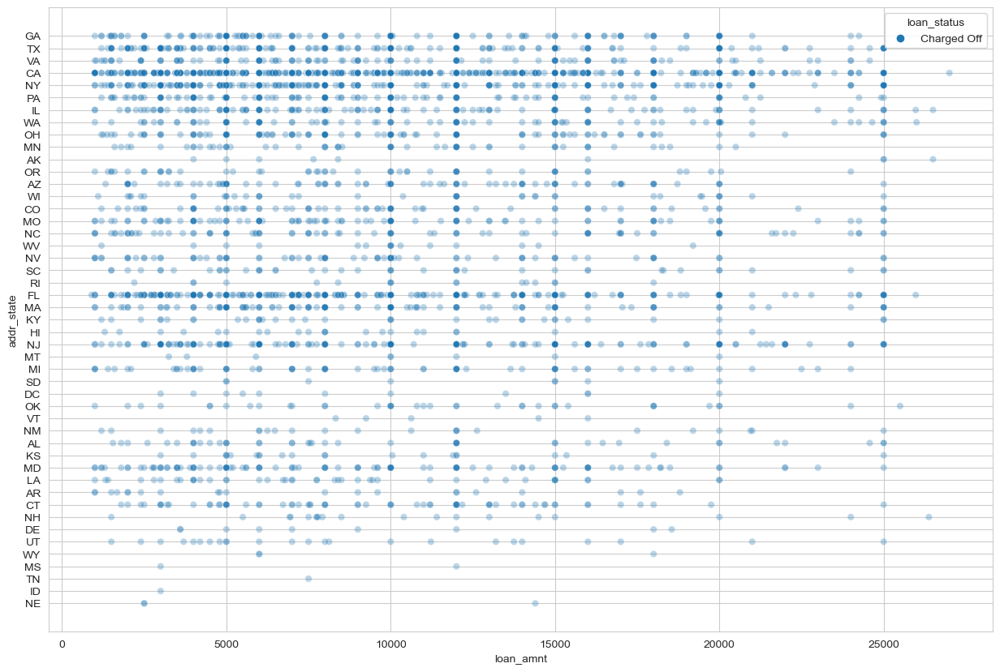

In [234]:
plt.figure(figsize = [15,10])
sns.scatterplot(x= 'loan_amnt',y='addr_state', data=charged_off, hue='loan_status',alpha=0.3)
plt.show()

<font color='purple'>Borrowers from California State with loan amount under 17k are likely to become defaulters

In [235]:
charged_off[['loan_amnt_bins','addr_state','loan_status']].value_counts()[:5]

loan_amnt_bins      addr_state  loan_status
(6100.0, 11700.0]   CA          Charged Off    281
(472.0, 6100.0]     CA          Charged Off    272
(11700.0, 17300.0]  CA          Charged Off    182
(472.0, 6100.0]     FL          Charged Off    147
                    NY          Charged Off    132
Name: count, dtype: int64

<font color='blue'>Loan amount vs Term</font>

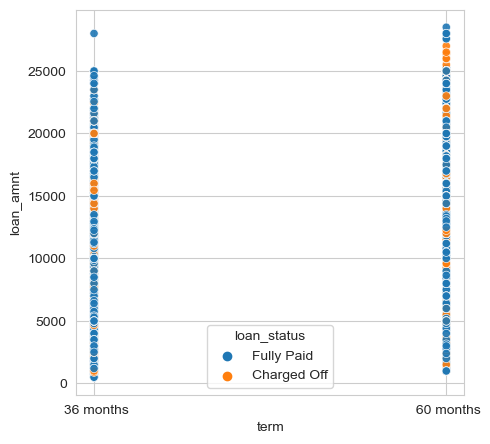

In [250]:
plt.figure(figsize = [5,5])
sns.scatterplot(y= 'loan_amnt',x='term', data=loan,hue='loan_status',alpha=0.9)
plt.show()

<font color='purple'>Regardless of loan amount, Defaulters are high in both 60months and 30 months tenure</font>

<font color='blue'>Annual income vs Dti</font>

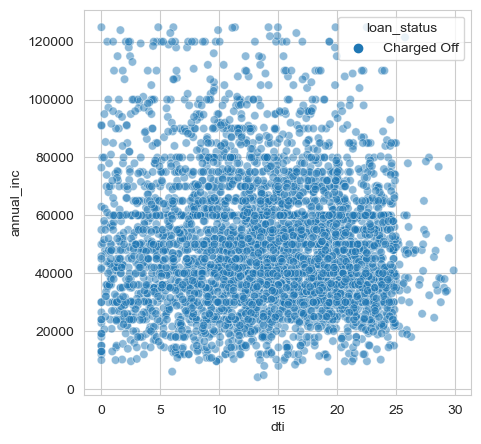

In [238]:
plt.figure(figsize = [5,5])
sns.scatterplot(y= 'annual_inc',x='dti', data=charged_off,hue='loan_status', alpha=0.5)
plt.show()

<font color='purple'>More Defaulter's DTI ranges from 10 to 25 and loan amount between 20k to 60k

<font color='blue'>Annual income vs Grade</font>

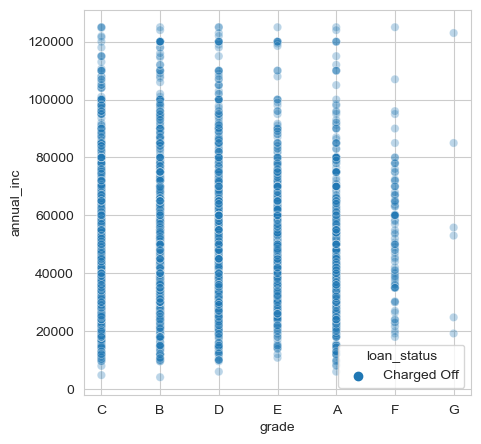

In [256]:
plt.figure(figsize = [5,5])
sns.scatterplot(y= 'annual_inc',x='grade', data=charged_off, hue='loan_status', alpha=0.3)
plt.show()

<font color='purple'>Borrower's Annual income between 28k to 52k with B or C grades are likely to become defaulters

In [240]:
charged_off[['annual_inc_bins','grade','loan_status']].value_counts()[:2]

annual_inc_bins     grade  loan_status
(28200.8, 52401.6]  B      Charged Off    533
                    C      Charged Off    507
Name: count, dtype: int64

<font color='blue'>Annual income vs Loan amount</font>

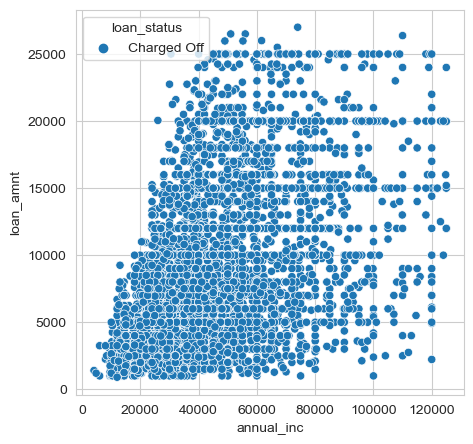

In [241]:
plt.figure(figsize = [5,5])
sns.scatterplot(x= 'annual_inc',y='loan_amnt', data=charged_off, hue='loan_status')
plt.show()

<font color='purple'>Majority of Defaulters comprises under 17.3k loan amount and annual income from 28.2k to 52.4k.

In [242]:
charged_off[['annual_inc_bins','loan_amnt_bins','loan_status']].value_counts()[:9]

annual_inc_bins      loan_amnt_bins      loan_status
(28200.8, 52401.6]   (472.0, 6100.0]     Charged Off    681
                     (6100.0, 11700.0]   Charged Off    608
(3878.996, 28200.8]  (472.0, 6100.0]     Charged Off    412
(28200.8, 52401.6]   (11700.0, 17300.0]  Charged Off    410
(52401.6, 76602.4]   (11700.0, 17300.0]  Charged Off    320
                     (472.0, 6100.0]     Charged Off    293
                     (6100.0, 11700.0]   Charged Off    290
(3878.996, 28200.8]  (6100.0, 11700.0]   Charged Off    179
(52401.6, 76602.4]   (17300.0, 22900.0]  Charged Off    158
Name: count, dtype: int64

<font color='blue'>Annual income vs employment length</font>

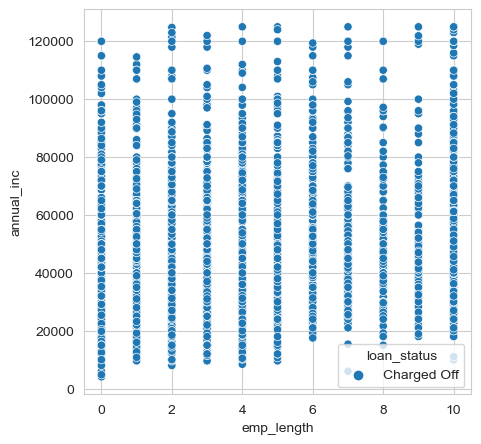

In [255]:
plt.figure(figsize = [5,5])
sns.scatterplot(y= 'annual_inc',x='emp_length', data=charged_off, hue='loan_status')
plt.show()

<font color='purple'>Borrower's Annual income from 28k to 53k with 10yrs of employment experience are likely to become defaulters

In [244]:
charged_off[['annual_inc_bins','emp_length','loan_status']].value_counts()[:3]

annual_inc_bins     emp_length  loan_status
(28200.8, 52401.6]  10.0        Charged Off    329
(52401.6, 76602.4]  10.0        Charged Off    309
(28200.8, 52401.6]  4.0         Charged Off    254
Name: count, dtype: int64

<font color='blue'>Annual income vs Address State</font>

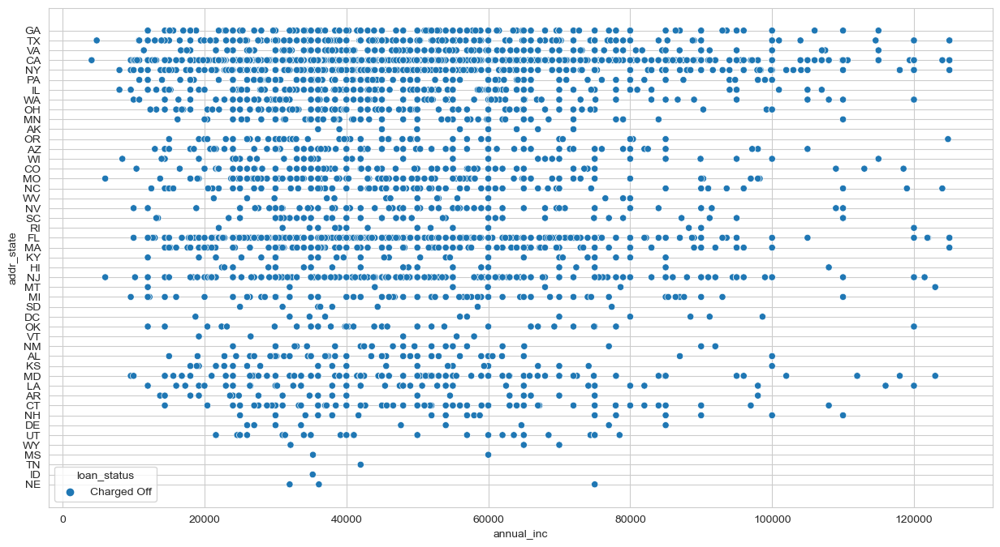

In [245]:
plt.figure(figsize = [15,8])
sns.scatterplot(x= 'annual_inc',y='addr_state', data=charged_off, hue='loan_status')
plt.show()

<font color='purple'>Borrowers from Califronia and Florida states with annual income under 80k are likely to become defaulters

In [246]:
charged_off[['annual_inc_bins','addr_state','loan_status']].value_counts()[:5]

annual_inc_bins     addr_state  loan_status
(28200.8, 52401.6]  CA          Charged Off    372
(52401.6, 76602.4]  CA          Charged Off    247
(28200.8, 52401.6]  FL          Charged Off    183
                    NY          Charged Off    170
                    TX          Charged Off    103
Name: count, dtype: int64

<font color='blue'>Installment vs Interest rate</font>

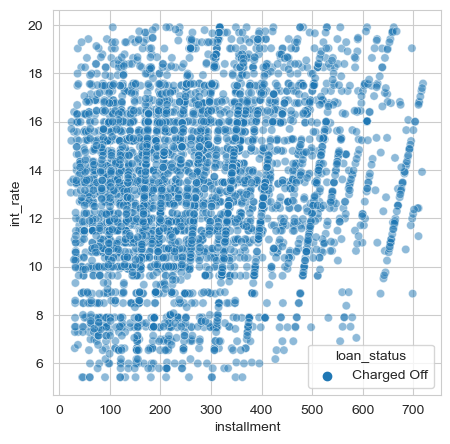

In [247]:
plt.figure(figsize = [5,5])
sns.scatterplot(x= 'installment',y='int_rate', data=charged_off, hue='loan_status',alpha=0.5)
plt.show()

<font color='purple'>Borrower's with Installment from 156 to 296 with interest rates from 8 to 17 are likely to become defaulters

In [164]:
charged_off[['installment_bins','int_rate_bins','loan_status']].value_counts()[:5]

installment_bins    int_rate_bins     loan_status
(156.322, 296.954]  (11.216, 14.114]  Charged Off    435
                    (14.114, 17.012]  Charged Off    400
(14.987, 156.322]   (11.216, 14.114]  Charged Off    347
(296.954, 437.586]  (11.216, 14.114]  Charged Off    331
(156.322, 296.954]  (8.318, 11.216]   Charged Off    290
Name: count, dtype: int64

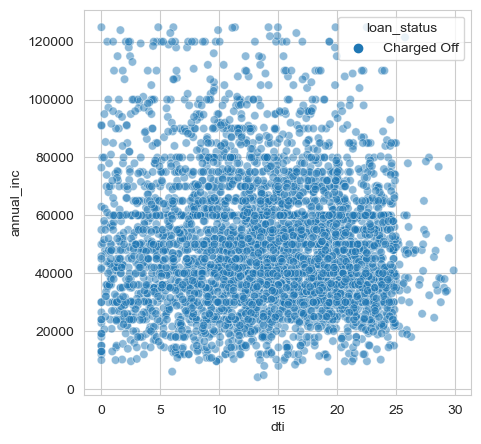

In [253]:
plt.figure(figsize = [5,5])
sns.scatterplot(x= 'dti',y='annual_inc', data=charged_off, hue='loan_status',alpha=0.5)
plt.show()

##### Observations:

- <font color='purple'>Grades B,C & D Has high number of Defaulters
- <font color='purple'>Sub grades B3,B5,C1,B4,C2,A5 has higher number of Defaulters
- <font color='purple'>No source/Income verificatioin has high Defaulters
- <font color='purple'>Employment length within 4/0/10yrs has high number of defaulters.
- <font color='purple'>Lower Revolving balance with loan amount under 10k has higher Defaulters
- <font color='purple'>Higher the Revolving utility wtih loan amount under 15k has higher number of defaulters
- <font color='purple'>Rented house Borrowers under 17.3k loan amount are likely to become of Defaulters.
- <font color='purple'>Borrower's under loan amount under 17k, Interest rates from 8 to 13.49 are likely to become defaulters
- <font color='purple'>Borrower's Loan purpose as Debt consolidation with loan amount under 23k are likely to become defaulters
- <font color='purple'>Borrowers from California State with loan amount under 17k are likely to become defaulters
- <font color='purple'>Regardless of loan amount Defaulters are high in both 60months and 30 months tenure</font>
- <font color='purple'>More Defaulter's DTI ranges from 10 to 25 and loan amount between 20k to 60k
- <font color='purple'>Borrower's Annual income between 28k to 52k with B or C grades are likely to become defaulters
- <font color='purple'>Majority of Defaulters comprises under 17.3k loan amount and annual income from 28.2k to 52.4k.
- <font color='purple'>Borrower's Annual income from 28k to 53k with 10yrs of employment experience are likely to become defaulters
- <font color='purple'>Borrowers from Califronia and Florida states with annual income under 80k are likely to become defaulters
- <font color='purple'>Borrower's with Installment from 156 to 296 with interest rates from 8 to 17 are likely to become defaulters

### Multivariate Analysis

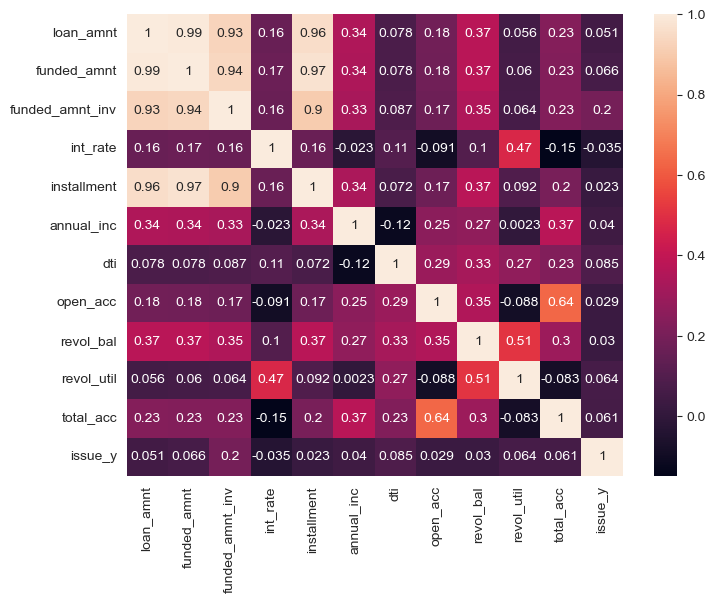

In [257]:
plt.figure(figsize=(8,6))
sns.heatmap(loan[num_cols].corr(method='spearman'),annot=True)
plt.show()

##### Highly Correlated:
- Loan amount is highly correlated with funded amount, funded amount by investors, installment.
- Funded amount and funded amount by investors are highly correlated with installment and loan amount.

##### Less Correlated:
- Loan amount is less correlated with interest rates, annual income, dti, open accounts, total accounts, revolving balance and revolving utility.
- Interest rate is less correlated with dti ratio, revolving balance, revolving utility
- Installment is less correlated with interest rates, dti, open accounts, total accounts, revolving balance and revolving utility.
- Annual income is less correlated with other numerical columns.
- Revolving balance, open accounts, total accounts and dti are less correlated with others.

##### Negatively correlated:
- Interest rates negatively correlated with annual income, open accounts and total accounts.
- Annual income and dti are negatively correlated.
- Open accounts and total accounts are negatively correlated with revolving utility.
